In [125]:
%matplotlib inline

# Mathematical and array operations
import math
import numpy as np
import pandas as pd

# System and random seed management
import os
import random

# Custom dataset utilities
import machine_learning_datasets as mldatasets

# Scikit-learn utilities for modeling and evaluation
from sklearn import metrics, ensemble, tree, inspection, model_selection
from sklearn.metrics import root_mean_squared_error, r2_score

# CatBoost for gradient boosting
import catboost as cb

# Visualization libraries
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns

# Interpretability libraries
import shap  # SHAP values for feature importance
from pdpbox import pdp, info_plots  # Partial Dependence Plots
from PyALE import ale  # Accumulated Local Effects
from lime.lime_tabular import LimeTabularExplainer  # LIME explanations

### Understanding and Preparing the Data

In [2]:
# PROBLEM: A tech startup is building an eBay-like marketplace for used cars
# and needs to predict optimal listing prices. The US used car market sells
# ~40M vehicles yearly (2/3 of all auto sales), making accurate pricing crucial.
#
# CHALLENGE: Balance buyer/seller interests while minimizing seller friction.
# The startup wants to ask sellers for MINIMAL information before generating
# price estimates. Some details (make, model, color) can be auto-detected from
# photos, but others (transmission, cylinders) may vary and require input.
#
# GOAL: Identify which features are most important for price prediction so the
# startup can ask only essential questions, maximizing listing completion rates
# while maintaining pricing accuracy.
#
# APPROACH:
# 1. Train multiple models (CatBoost, Random Forest)
# 2. Evaluate model performance (RMSE, R², error distribution)
# 3. Calculate feature importance using multiple methods:
#    - Model-specific (built-in importance)
#    - Model-agnostic (permutation importance, SHAP values)
# 4. Create visualizations (PDP, ALE, interaction plots) to:
#    - Understand feature-outcome relationships
#    - Identify feature interactions
#    - Communicate findings to executives and data scientists
#
# DATA SOURCES:
# - Craigslist used car listings (primary)
# - U.S. Census Bureau (demographic data by location)
# - EPA (vehicle emissions and fuel economy data)

In [21]:
# Load the used cars dataset with automatic preprocessing
# The 'prepare=True' flag applies basic cleaning and imputation
usedcars_df = mldatasets.load("usedcars", prepare=True)

https://github.com/PacktPublishing/Interpretable-Machine-Learning-with-Python-2E/raw/main/datasets/usedcars-2e.csv.zip downloaded to D:\Tutorials\2025\XAI\04_Global_Model_Agnostic_Interpretation_Methods\data\usedcars-2e.csv.zip
D:\Tutorials\2025\XAI\04_Global_Model_Agnostic_Interpretation_Methods\data\usedcars-2e.csv.zip uncompressed to D:\Tutorials\2025\XAI\04_Global_Model_Agnostic_Interpretation_Methods\data\usedcars-2e.csv
1 dataset files found in D:\Tutorials\2025\XAI\04_Global_Model_Agnostic_Interpretation_Methods\data\usedcars-2e.csv folder
parsing D:\Tutorials\2025\XAI\04_Global_Model_Agnostic_Interpretation_Methods\data\usedcars-2e.csv\usedcars_imputed.csv


In [22]:
usedcars_df

,price,region,posting_date,lat,long,state,city,zip,make,make_cat,...,model_type,drive,cylinders,title_status,condition,epa_co2,epa_displ,zip_population,zip_density,est_households_medianincome_usd
id,,,,,,,,,,,,,,,,,,,,,
7316814884,33590,auburn,2021-05-04T12:31:18-0500,32.59000,-85.480000,AL,Auburn,36830,gmc,regular,...,pickup,4wd,8,clean,good,-1.0,4.8,48282.0,170.2,53972.0
7316422333,33590,birmingham,2021-05-03T15:51:15-0500,33.52000,-86.790000,AL,Birmingham,35233,gmc,regular,...,pickup,4wd,8,clean,good,-1.0,4.8,2469.0,626.1,41994.0
7315472478,33590,dothan,2021-05-01T15:01:00-0500,31.23000,-85.400000,AL,Dothan,36303,gmc,regular,...,pickup,4wd,8,clean,good,-1.0,4.8,31269.0,205.1,44639.0
7316827853,33590,gadsden-anniston,2021-05-04T12:51:28-0500,34.01000,-86.010000,AL,Gadsden,35901,gmc,regular,...,pickup,4wd,8,clean,good,-1.0,4.8,18827.0,122.8,39688.0
7315513814,33590,huntsville / decatur,2021-05-01T16:21:14-0500,34.57000,-86.980000,AL,Decatur,35601,gmc,regular,...,pickup,4wd,8,clean,good,-1.0,4.8,34682.0,505.5,43267.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7303660605,26800,wyoming,2021-04-08T09:40:04-0600,45.78130,-108.572700,MT,Billings,59102,ram,regular,...,pickup,4wd,8,clean,like new,578.0,5.7,48325.0,1240.8,59569.0
7302963673,18000,wyoming,2021-04-06T21:04:03-0600,43.45280,-110.739300,WY,Jackson,83001,chevrolet,regular,...,pickup,4wd,8,lien,excellent,-1.0,5.3,17984.0,14.4,82396.0
7302963273,18000,wyoming,2021-04-06T21:02:26-0600,43.45280,-110.739300,WY,Jackson,83001,jeep,regular,...,SUV,4wd,8,clean,good,-1.0,5.9,17984.0,14.4,82396.0


In [23]:
# Display dataset structure and data types
# Shows 256,065 records with 29 columns (11 float, 5 int, 13 object)
usedcars_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 256065 entries, 7316814884 to 7302338378
Data columns (total 29 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   price                            256065 non-null  int64  
 1   region                           256065 non-null  object 
 2   posting_date                     256065 non-null  object 
 3   lat                              256065 non-null  float64
 4   long                             256065 non-null  float64
 5   state                            256065 non-null  object 
 6   city                             256065 non-null  object 
 7   zip                              256065 non-null  object 
 8   make                             256065 non-null  object 
 9   make_cat                         256065 non-null  object 
 10  make_pop                         256065 non-null  float64
 11  model                            256065 non-null  object 

In [24]:
# The data dictionary for the dataset is as follows:

# Variables related to the listing:
# • price: target, continuous, the price posted for the vehicle

# • region: categorical, the region for the listing—usually this is a city, metropolitan area, 
# or (for more rural areas) a portion of a state or a least populated state (out of 402)

# • posting_date: datetime, the date and time of the posting (all postings are for a single 
# month period in 2021 so you cannot observe seasonal patterns with it)

# • lat: continuous, the latitude in decimal format

# • long: continuous, the longitude in decimal format

# • state: categorical, the two-letter state code (out of 51 including [DC])

# • city: categorical, the name of the city (out of over 6,700)

# • zip: nominal, the zip code (out of over 13,100)

# Variables related to the vehicle:
# • make: categorical, the brand or manufacturer of the vehicle (out of 37)

# • make_cat: categorical, the category for the make (out of 5). It’s [obsolete] for makes no 
# longer produced, such as “Saturn,” [luxury sports] for brands like “Ferrari,” and [luxury] 
# for brands like “Mercedes-Benz.” Everything else is [regular] or [premium]. The only 
# difference is that [premium] include brands like “Cadillac” and “Acura,” which are the 
# high-end brands of car manufacturers in the [regular] category.

# • make_pop: continuous, the relative popularity of the make in percentiles (0–1)

# • model: categorical, the model (out of over 17,000)

# • model_premier: binary, whether the model is a luxury version/trim of a model (if 
# the model itself is not already high-end such as those in the luxury, luxury sports, or 
# premium categories)

# • year: ordinal, the year of the model (from 1984–2022)

# • make_yr_pop: continuous, the relative popularity of the make for the year it was made 
# for in percentiles (0–1) 

# • model_yr_pop: continuous, the relative popularity of the model for the year it was 
# made in percentiles (0–1) 

# • odometer: continuous, the reading in the vehicle’s odometer

# • auto_trans: binary, whether the car has automatic transmission—otherwise, it is manual

# • fuel: categorical, the type of fuel used (out of 5: [gas], [diesel], [hybrid], [electric] and 
# [other])
                                                                       
# • model_type: categorical (out of 13: [sedan], [SUV], and [pickup] are the three most 
# popular, by far)
                                                                       
# • drive: categorical, whether it’s four-wheel, front-wheel, or rear-wheel drive (out of 3: 
# [4wd], [fwd] and [rwd])
                                                                       
# • cylinders: nominal, the number of cylinders of the engine (from 2–16). Generally, the 
# more cylinders, the higher the horsepower
                                                                       
# • title_status: categorical, what the title says about the status of the vehicle (out of 7 
# like [clean], [rebuilt], [unknown], [salvage], and [lien])
                                                                       
# • condition: categorical, what the owner reported the condition of the vehicle to be (out 
# of 7 like [good], [unknown], [excellent] and [like new])
                                                                       
# Variables related to the emissions of the vehicle:
# • epa_co2: continuous, tailpipe CO2 in grams/mile. For models after 2013, it is based 
# on EPA tests. For previous years, CO2 is estimated using an EPA emission factor (-1 = 
# not vvailable)
                                                                       
# • epa_displ: continuous, the engine displacement (in liters 0.6–8.4)

# Variables related to the ZIP code of the listing:
# • zip_population: continuous, the population
                                                                       
# • zip_density: continuous, the density (residents per sq. mile)
                                                                       
# • est_households_medianincome_usd: continuous, the median household income

In [25]:
# Create a backup of the original dataset for reference
usedcars_orig_df = usedcars_df.copy()

In [26]:
# Convert categorical variables to binary dummy variables
# 'min_recs' parameter ensures only categories with enough samples are encoded
# Rare categories are grouped into 'other' or 'defcatname'

# Encode fuel types (gas, diesel, hybrid, electric, other)
usedcars_df = mldatasets.make_dummies_with_limits(
    usedcars_df, 'fuel', 
    min_recs=500,  # Minimum 500 records required
    defcatname='other'  # Default category for rare types
)

# Encode car make categories (luxury, premium, regular, etc.)
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'make_cat')

# Encode vehicle body types (sedan, SUV, pickup, etc.)
usedcars_df = mldatasets.make_dummies_with_limits(
    usedcars_df, 'model_type',
    min_recs=500, 
    defcatname='other'
)

# Encode vehicle condition (excellent, good, fair, etc.)
usedcars_df = mldatasets.make_dummies_with_limits(
    usedcars_df, 'condition',
    min_recs=200,  # Lower threshold for condition
    defcatname='other'
)

# Encode drivetrain types (FWD, RWD, 4WD)
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'drive')

# Encode title status (clean, rebuilt, salvage, etc.)
usedcars_df = mldatasets.make_dummies_with_limits(
    usedcars_df, 'title_status',
    min_recs=500, 
    defcatname='other'
)

# After all your make_dummies_with_limits calls
bool_cols = usedcars_df.select_dtypes(include='bool').columns
usedcars_df[bool_cols] = usedcars_df[bool_cols].astype(int)

In [27]:
usedcars_df

,price,region,posting_date,lat,long,state,city,zip,make,make_pop,...,condition_unknown,drive_4wd,drive_fwd,drive_rwd,title_status_clean,title_status_lien,title_status_other,title_status_rebuilt,title_status_salvage,title_status_unknown
id,,,,,,,,,,,,,,,,,,,,,
7316814884,33590,auburn,2021-05-04T12:31:18-0500,32.59000,-85.480000,AL,Auburn,36830,gmc,0.842105,...,0,1,0,0,1,0,0,0,0,0
7316422333,33590,birmingham,2021-05-03T15:51:15-0500,33.52000,-86.790000,AL,Birmingham,35233,gmc,0.842105,...,0,1,0,0,1,0,0,0,0,0
7315472478,33590,dothan,2021-05-01T15:01:00-0500,31.23000,-85.400000,AL,Dothan,36303,gmc,0.842105,...,0,1,0,0,1,0,0,0,0,0
7316827853,33590,gadsden-anniston,2021-05-04T12:51:28-0500,34.01000,-86.010000,AL,Gadsden,35901,gmc,0.842105,...,0,1,0,0,1,0,0,0,0,0
7315513814,33590,huntsville / decatur,2021-05-01T16:21:14-0500,34.57000,-86.980000,AL,Decatur,35601,gmc,0.842105,...,0,1,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7303660605,26800,wyoming,2021-04-08T09:40:04-0600,45.78130,-108.572700,MT,Billings,59102,ram,0.789474,...,0,1,0,0,1,0,0,0,0,0
7302963673,18000,wyoming,2021-04-06T21:04:03-0600,43.45280,-110.739300,WY,Jackson,83001,chevrolet,0.973684,...,0,1,0,0,0,1,0,0,0,0
7302963273,18000,wyoming,2021-04-06T21:02:26-0600,43.45280,-110.739300,WY,Jackson,83001,jeep,0.868421,...,0,1,0,0,1,0,0,0,0,0


In [28]:
usedcars_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 256065 entries, 7316814884 to 7302338378
Data columns (total 60 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   price                            256065 non-null  int64  
 1   region                           256065 non-null  object 
 2   posting_date                     256065 non-null  object 
 3   lat                              256065 non-null  float64
 4   long                             256065 non-null  float64
 5   state                            256065 non-null  object 
 6   city                             256065 non-null  object 
 7   zip                              256065 non-null  object 
 8   make                             256065 non-null  object 
 9   make_pop                         256065 non-null  float64
 10  model                            256065 non-null  object 
 11  model_premier                    256065 non-null  int64  

In [29]:
# Check remaining object (string) columns that weren't encoded
# These are typically high-cardinality features like region, city, zip
usedcars_df.dtypes[lambda x: x == object].index.tolist()

['region', 'posting_date', 'state', 'city', 'zip', 'make', 'model']

In [30]:
# We don’t need any of these columns since we have latitude, longitude, and some of the demographic 
# features, which provide the model with some idea of where the car was being sold. As for the make 
# and model, we have the make and model popularity and category features. We can remove the non-nu
# merical features by simply only selecting the numerical ones

# Remove remaining non-numeric columns (strings/objects)
# Keep only numeric features for modeling
usedcars_df = usedcars_df.select_dtypes(include=(int, float, np.uint8))

In [31]:
usedcars_df

,price,lat,long,make_pop,model_premier,year,make_yr_pop,model_yr_pop,odometer,auto_trans,...,condition_unknown,drive_4wd,drive_fwd,drive_rwd,title_status_clean,title_status_lien,title_status_other,title_status_rebuilt,title_status_salvage,title_status_unknown
id,,,,,,,,,,,,,,,,,,,,,
7316814884,33590,32.59000,-85.480000,0.842105,0,2014,0.878788,0.995349,57923.0,1,...,0,1,0,0,1,0,0,0,0,0
7316422333,33590,33.52000,-86.790000,0.842105,0,2014,0.878788,0.995349,57923.0,1,...,0,1,0,0,1,0,0,0,0,0
7315472478,33590,31.23000,-85.400000,0.842105,0,2014,0.878788,0.995349,57923.0,1,...,0,1,0,0,1,0,0,0,0,0
7316827853,33590,34.01000,-86.010000,0.842105,0,2014,0.878788,0.995349,57923.0,1,...,0,1,0,0,1,0,0,0,0,0
7315513814,33590,34.57000,-86.980000,0.842105,0,2014,0.878788,0.995349,57923.0,1,...,0,1,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7303660605,26800,45.78130,-108.572700,0.789474,0,2014,0.787879,0.986425,110000.0,1,...,0,1,0,0,1,0,0,0,0,0
7302963673,18000,43.45280,-110.739300,0.973684,0,2005,0.971429,1.000000,130000.0,1,...,0,1,0,0,0,1,0,0,0,0
7302963273,18000,43.45280,-110.739300,0.868421,0,1990,0.892857,0.036036,114400.0,1,...,0,1,0,0,1,0,0,0,0,0


In [32]:
rand = 42  # Master random seed
os.environ['PYTHONHASHSEED'] = str(rand)  # Python hash seed
np.random.seed(rand)  # NumPy random seed
random.seed(rand)  # Python random seed

# Define target variable (what we're predicting)
target_col = 'price'

# Separate features (X) from target (y)
X = usedcars_df.drop([target_col], axis=1)
y = usedcars_df[target_col]

# Split data into training (75%) and testing (25%) sets
X_train, X_test, y_train, y_test = model_selection.train_test_split(
    X, y, 
    test_size=0.25,  # 25% for testing
    random_state=rand
)

## Model Training & Evaluation

In [33]:
# Initialize CatBoost regressor with specific hyperparameters
cb_mdl = cb.CatBoostRegressor(
    depth=7,  # Maximum tree depth
    learning_rate=0.2,  # Step size for gradient descent
    random_state=rand,
    verbose=False  # Suppress training output
)

# Train the CatBoost model
cb_mdl = cb_mdl.fit(X_train, y_train)

# Initialize Random Forest regressor
rf_mdl = ensemble.RandomForestRegressor(
    n_jobs=-1,  # Use all available CPU cores
    random_state=rand
)

# Train the Random Forest model
# Convert to numpy arrays for compatibility
rf_mdl = rf_mdl.fit(X_train.to_numpy(), y_train.to_numpy())

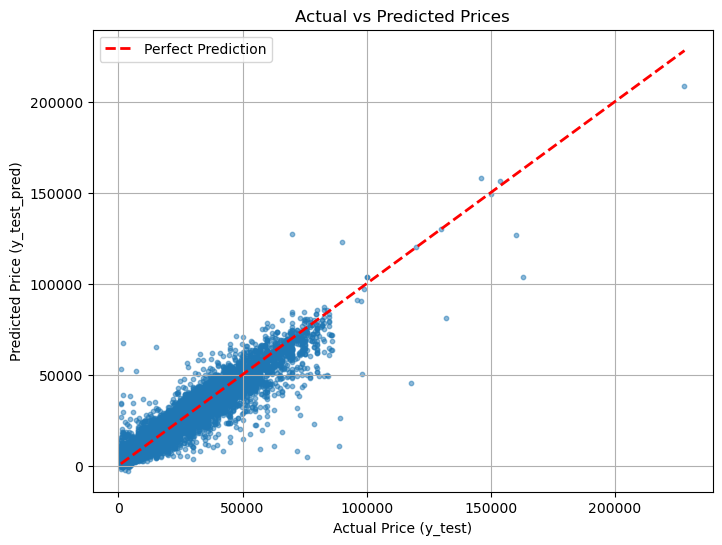

RMSE_train: 2543.4672	RMSE_test: 3099.8195	r2: 0.9444


In [37]:
# Set CatBoost as the primary model for evaluation
mdl = cb_mdl

# Calculate RMSE manually
y_train_pred = mdl.predict(X_train)
y_test_pred = mdl.predict(X_test)

y_true = y_test.values  # extract the price values
y_pred = y_test_pred    # already a numpy array

plt.figure(figsize=(8, 6))
plt.scatter(y_true, y_pred, alpha=0.5, s=10)  # smaller dots for large datasets
plt.plot([y_true.min(), y_true.max()],
         [y_true.min(), y_true.max()],
         'r--', lw=2, label='Perfect Prediction')

plt.xlabel('Actual Price (y_test)')
plt.ylabel('Predicted Price (y_test_pred)')
plt.title('Actual vs Predicted Prices')
plt.legend()
plt.grid(True)
plt.show()

rmse_train = root_mean_squared_error(y_train, y_train_pred)
rmse_test = root_mean_squared_error(y_test, y_test_pred)
r2 = r2_score(y_test, y_test_pred)

print(f"RMSE_train: {rmse_train:.4f}\tRMSE_test: {rmse_test:.4f}\tr2: {r2:.4f}")

In [38]:
# Calculate percentage of predictions within $4,000 error threshold
thresh = 4000
pct_under = np.where(
    np.abs(y_test - y_test_pred) < thresh, 1, 0
).sum() / len(y_test)
print(f"Percentage of test samples under ${thresh:,.0f} in absolute error {pct_under:.1%}")

Percentage of test samples under $4,000 in absolute error 89.9%


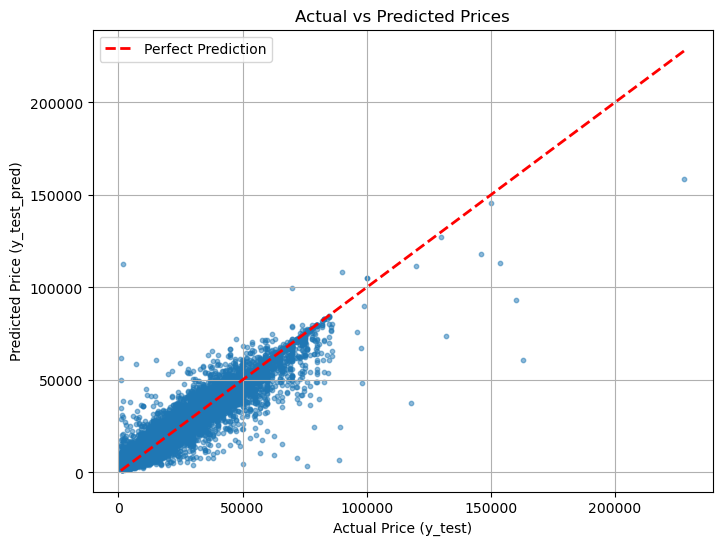

RMSE_train: 1158.2029	RMSE_test: 3074.9148	r2: 0.9453


In [39]:
# Evaluate Random Forest model for comparison
mdl = rf_mdl

# Calculate RMSE manually
y_train_pred = mdl.predict(X_train)
y_test_pred = mdl.predict(X_test)

y_true = y_test.values  # extract the price values
y_pred = y_test_pred    # already a numpy array

plt.figure(figsize=(8, 6))
plt.scatter(y_true, y_pred, alpha=0.5, s=10)  # smaller dots for large datasets
plt.plot([y_true.min(), y_true.max()],
         [y_true.min(), y_true.max()],
         'r--', lw=2, label='Perfect Prediction')

plt.xlabel('Actual Price (y_test)')
plt.ylabel('Predicted Price (y_test_pred)')
plt.title('Actual vs Predicted Prices')
plt.legend()
plt.grid(True)
plt.show()

rmse_train = root_mean_squared_error(y_train, y_train_pred)
rmse_test = root_mean_squared_error(y_test, y_test_pred)
r2 = r2_score(y_test, y_test_pred)

print(f"RMSE_train: {rmse_train:.4f}\tRMSE_test: {rmse_test:.4f}\tr2: {r2:.4f}")

## What is feature importance?

In [44]:
# CONCEPT: Feature importance measures how much each feature contributes to
# the model's predictions. Easy for linear models (coefficients), harder for
# non-linear models (tree ensembles, neural networks).
#
# ANALOGY - Two Team Sports:
# - Relay Race = Linear Model: Each runner's contribution is independent and
#   easy to measure (just their split time). Like linear regression coefficients.
# - Basketball = Non-linear Model: Players have different roles, interact
#   differently based on game conditions. Hard to quantify individual impact.
#   Like tree-based models where features interact in complex ways.

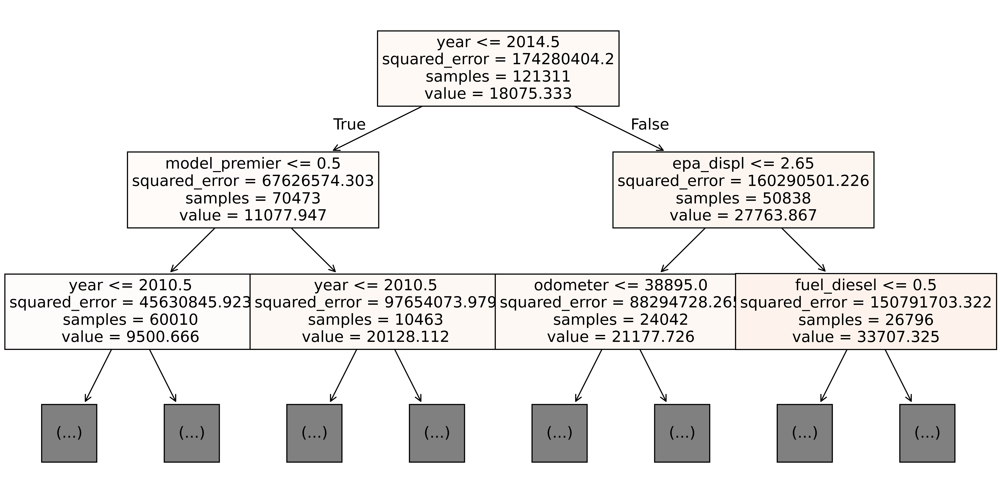

In [40]:
# Plot the first tree from Random Forest to visualize decision logic
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(16, 8), dpi=600)
tree.plot_tree(
    rf_mdl.estimators_[0],  # First tree in the forest
    feature_names=X_train.columns,
    filled=True,  # Color nodes by value
    max_depth=2,  # Show only top 2 levels
    fontsize=14
)
fig.show()

In [45]:
# 1. RANDOM FOREST - Mean Decrease in Impurity (Gini/MSE):
#    - Measures how much each feature reduces node impurity when splitting
#    - Calculated as weighted sum of impurity decreases across all trees
#    - Values normalized to sum to 1.0 (100%)
#    - Fast to compute, but biased toward high-cardinality features

In [41]:
# Random Forest feature importance (Gini impurity-based)
rf_feat_imp = rf_mdl.feature_importances_
print(rf_feat_imp)
print(f"Sum of importances: {sum(rf_feat_imp)}")  # Should equal 1.0

[8.27435826e-03 1.05316891e-02 2.41376641e-02 5.91421757e-02
 4.59888312e-01 2.36497116e-02 1.73254921e-02 9.41039384e-02
 1.13595842e-03 2.44903039e-02 1.52845147e-02 1.17932359e-01
 6.68909617e-03 7.26970607e-03 6.49519448e-03 3.73906562e-02
 3.35077351e-05 2.08595484e-03 1.06105564e-04 7.35524118e-04
 3.71629481e-03 1.37587550e-03 3.62514722e-05 1.35433058e-03
 1.85942291e-02 2.25594767e-03 4.58569071e-04 5.88135573e-04
 1.17333990e-04 3.57957275e-04 1.04637636e-03 1.85825529e-02
 3.04228803e-03 2.76059120e-03 6.61424708e-04 6.88477978e-05
 1.32533130e-03 5.57300537e-04 7.98286843e-03 7.95490983e-04
 1.21376943e-04 2.40284349e-05 1.40877926e-03 5.16139425e-03
 5.76593121e-03 1.65879364e-03 1.98557685e-03 1.89424809e-04
 3.60991098e-05 6.94700818e-04 2.98266787e-04 2.75408128e-04]
Sum of importances: 0.9999999999999999


In [46]:
# 2. CATBOOST - PredictionValuesChange (default):
#    - Measures average prediction change when feature value changes
#    - Traverses trees, weighted by samples in each branch
#    - Splits credit evenly when features interact in a node
#    - Values sum to 100.0
#    - WARNING: Can mislead for frequently interacting features

In [42]:
# CatBoost feature importance (prediction value change-based)
cb_feat_imp = cb_mdl.feature_importances_
print(cb_feat_imp)
print(f"Sum of importances: {sum(cb_feat_imp)}")  # Should equal 100.0

[1.23241338e+00 1.47250731e+00 5.10854175e+00 5.06215588e+00
 2.32428685e+01 2.49396877e+00 2.34425124e+00 1.30525170e+01
 3.62293240e-01 5.05852371e+00 4.02843847e+00 9.94625509e+00
 5.91470586e-01 6.56065556e-01 6.44118827e-01 6.15577710e+00
 4.52983204e-03 4.43591782e-01 1.97928036e-02 1.13317838e-01
 9.36855026e-01 7.15847753e-01 1.45702595e-02 1.50436254e-01
 3.20122608e+00 4.66538937e-01 4.35409660e-02 5.65100050e-02
 1.20649331e-02 7.26020698e-02 2.57216240e-01 3.41471177e+00
 8.61301597e-01 4.76814546e-01 1.41586247e-01 1.53973282e-02
 7.93089927e-02 1.52855942e-01 1.92784381e+00 9.89543927e-02
 5.87334128e-03 6.15126282e-03 4.08901733e-01 8.85913922e-01
 2.52940402e+00 3.18871605e-01 2.40918949e-01 2.57587858e-02
 3.64708812e-03 2.48937147e-01 1.27365951e-01 6.86744613e-02]
Sum of importances: 100.0


In [43]:
# Create comparison DataFrame of feature importances
feat_imp_df = pd.DataFrame({
    'feature': X_train.columns, 
    'cb_feat_imp': cb_feat_imp,
    'rf_feat_imp': rf_feat_imp * 100  # Scale RF to percentage
})

# Sort by CatBoost importance (descending)
feat_imp_df = feat_imp_df.sort_values('cb_feat_imp', ascending=False)

# Display styled table with bar charts
feat_imp_df.style.format(
    '{:.2f}%', 
    subset=['cb_feat_imp', 'rf_feat_imp']
).bar(
    subset=['cb_feat_imp', 'rf_feat_imp'], 
    color='#4EF',  # Light blue bars
    width=100
)
# Top features: year (23-46%), odometer (9-13%), epa_displ (10-12%)

,feature,cb_feat_imp,rf_feat_imp
4,year,23.24%,45.99%
7,odometer,13.05%,9.41%
11,epa_displ,9.95%,11.79%
15,fuel_diesel,6.16%,3.74%
2,make_pop,5.11%,2.41%
3,model_premier,5.06%,5.91%
9,cylinders,5.06%,2.45%
10,epa_co2,4.03%,1.53%
31,model_type_pickup,3.41%,1.86%
24,make_cat_regular,3.20%,1.86%


In [47]:
# LIMITATIONS OF MODEL-SPECIFIC IMPORTANCE:
# - Different models give different rankings (year is #1 for both, but
#   odometer ranks differently: RF=9%, CB=13%)
# - Method-specific biases (impurity vs. prediction change)
# - Can't compare across model types (trees vs. linear vs. neural nets)
# - May not reflect true predictive power
#
# SOLUTION: Use MODEL-AGNOSTIC METHODS:
# - Permutation importance: Shuffle feature, measure performance drop
# - SHAP values: Game theory-based contribution allocation
# - These work consistently across any model type

## Assessing Feature Importance with Model-agnostic Methods

In [51]:
# ASSESSING FEATURE IMPORTANCE WITH MODEL-AGNOSTIC METHODS
#
# THE "BLACK-BOX" APPROACH
# - Definition: Methods that work for ANY model, regardless of its internal structure (e.g., linear regression, deep learning, etc.).
# - Key Principle: We treat the model as an opaque box where only the INPUTS and OUTPUTS are visible.
# - Independence: These methods DO NOT rely on intrinsic model parameters (like `.coef_` or `.feature_importances_`).
#
# THE CORE IDEA: MEASURING IMPACT THROUGH SIMULATION
# - Central Question: How can we tell which inputs are important if we can't see inside the model?
# - The "What If" Experiment: We systematically alter the inputs and measure the effect on the model's output or performance.
# - Analogy from the text: "Remove a random player from the game and observe the outcome!"
#
# - In ML terms:
#   - What happens to the model's accuracy if we randomly shuffle (and thus break the signal of) a single feature?
#   - If the performance drops significantly, that feature must have been important.
#   - If performance stays the same, the feature was likely unimportant.
#
# TWO KEY METHODS INTRODUCED:
#
# ✓ Permutation Feature Importance
# ✓ SHAP (SHapley Additive exPlanations)
#
# KEY TAKEAWAYS:
# 1. "Model-Agnostic" means universal: these techniques can be applied to any fitted model.
# 2. The focus shifts from analyzing model INTERNALS to observing model BEHAVIOR (input vs. output).
# 3. Importance is inferred by measuring the CONSEQUENCE of a feature's absence or corruption.

### Permutation Feature Importance

In [49]:
%%time
# Sample 30% of test data for computational efficiency
X_samp = X_test.sample(frac=0.3)
y_samp = y_test.loc[X_samp.index]

# Calculate permutation importance for CatBoost
# Shuffles each feature and measures performance degradation
cb_perm_imp = inspection.permutation_importance(
    cb_mdl, X_samp, y_samp,
    n_repeats=5,  # Repeat shuffling 5 times for stability
    random_state=rand,
    scoring='neg_mean_absolute_error'  # Use MAE as metric
)

# Calculate permutation importance for Random Forest
rf_perm_imp = inspection.permutation_importance(
    rf_mdl, 
    X_samp.to_numpy(),
    y_samp.to_numpy(), 
    n_repeats=5,
    random_state=rand, 
    scoring='neg_mean_absolute_error'
)

CPU times: total: 8min 26s
Wall time: 43.1 s


In [50]:
# Create comparison DataFrame of permutation importances
perm_imp_df = pd.DataFrame({
    'feature': X_train.columns, 
    'cb_perm_mean': cb_perm_imp.importances_mean,
    'cb_perm_std': cb_perm_imp.importances_std,
    'rf_perm_mean': rf_perm_imp.importances_mean,
    'rf_perm_std': rf_perm_imp.importances_std
})

# Sort by CatBoost permutation importance
perm_imp_df = perm_imp_df.sort_values('cb_perm_mean', ascending=False)

# Display styled table
perm_imp_df.style.format(
    '{:.4f}', 
    subset=['cb_perm_mean', 'cb_perm_std', 'rf_perm_mean', 'rf_perm_std']
).bar(
    subset=['cb_perm_mean', 'rf_perm_mean'], 
    color='#4EF', 
    width=100
)
# Top features by permutation: year (5424-6331), odometer (3015-3288), epa_displ (1331-2179)

,feature,cb_perm_mean,cb_perm_std,rf_perm_mean,rf_perm_std
4,year,5469.6114,17.8537,6381.3891,14.3311
7,odometer,3029.2987,16.3274,3289.6996,22.4841
11,epa_displ,1330.7051,16.0213,2191.0799,25.1505
9,cylinders,1049.3324,10.0008,1217.5801,16.4082
2,make_pop,996.2043,7.1443,521.5881,6.8384
3,model_premier,580.0383,13.7382,1149.4696,15.5622
10,epa_co2,558.8655,3.1452,720.9986,14.3755
31,model_type_pickup,548.2176,8.2829,539.4135,4.2696
5,make_yr_pop,546.1205,3.6921,488.1375,6.4764
24,make_cat_regular,483.7597,5.6140,703.0490,12.2885


In [53]:
# PERMUTATION FEATURE IMPORTANCE
# - A model-agnostic method to assess feature importance on an ALREADY TRAINED model.
# - Core Idea: Instead of removing a feature (which is impossible post-training), we
#   destroy its predictive value by shuffling it and measure the impact on performance.
#
# HOW IT WORKS (THE PROCESS):
# 1. Take a trained model and a test/validation dataset.
# 2. Calculate the baseline performance score (e.g., MAE, F1, R²) on the original data.
# 3. For a single feature:
#    a. Randomly shuffle (permute) all the values ONLY in that feature's column. This
#       breaks the relationship between that feature and the target variable.
#    b. Make predictions using the model on this modified dataset.
#    c. Calculate the new, likely worse, performance score.
#    d. The "importance" is the difference between the baseline score and the new score.
# 4. Repeat step 3 multiple times (`n_repeats`) for that same feature to get a stable average.
# 5. Repeat steps 3 & 4 for EVERY feature in the dataset.
#
# INTERPRETATION OF THE SCORE:
# - The importance value represents the AVERAGE INCREASE IN MODEL ERROR that occurs when a feature is made useless.
# - It accounts for both the main effect of the feature AND its interaction effects with other features.
#
# ✓ ADVANTAGES:
#   - Relatively fast to compute since no model retraining is required.
#   - Provides a more consistent importance ranking across different model types compared to intrinsic methods.
#   - Model-agnostic and intuitive.
#
# ⚠ DRAWBACKS & CAVEATS (CRITICAL):
#   - The specific numerical values should be "taken with a grain of salt."
#
#   1. MULTICOLLINEARITY PROBLEM:
#      - If two features are highly correlated, shuffling one may not significantly drop performance
#        because the other (unshuffled) feature still provides similar information.
#      - This leads to UNDERESTIMATING the importance of correlated features.
#
#   2. UNREALISTIC DATA PROBLEM:
#      - Shuffling can create impossible or out-of-distribution data points (e.g., winter temperatures in summer).
#      - The model, having never seen such data, might perform very poorly, causing an
#        OVERSTATEMENT of that feature's importance.
#
# FINAL RECOMMENDATION:
# - Permutation importance is most useful for RANKING features and understanding their RELATIVE impact
#   on a specific model, rather than for interpreting the absolute score values.

### SHAP Values

In [55]:
# SHAP VALUES (BASED ON SHAPLEY VALUES)
# - SHAP is a practical and popular implementation of a concept from game theory called Shapley Values.
#
# THE CORE CONCEPT: COOPERATIVE GAME THEORY
# - The method explains feature importance by treating a model's prediction as a "game."
# - Analogy:
#   - Players → Features
#   - Coalitions → Different combinations/subsets of features.
#   - The Game → Making a prediction with a specific coalition of features.
#   - Payout / Score → The model's output for that prediction.
#   - Marginal Contribution → The amount a single feature changes the payout when it joins a coalition.
#
# - The Shapley Value: For a single feature, it is the FAIR PAYOUT, calculated as the
#   AVERAGE of its marginal contributions across all possible coalitions it could join.
#
# HOW THIS IMPROVES ON PERMUTATION IMPORTANCE
# - Key Difference: Permutation importance shuffles one feature at a time in isolation.
#   Shapley values consider every possible COMBINATION of features.
# - Main Benefit: This focus on feature combinations helps to properly attribute importance
#   even when features are correlated, thus tackling the multicollinearity issue.
#
# ✓ KEY MATHEMATICAL PROPERTIES (WHY SHAPLEY VALUES ARE TRUSTWORTHY)
#   The calculated values satisfy several desirable properties that make them fair and consistent.
#
#   1. ADDITIVITY / EFFICIENCY:
#      - The sum of all feature contributions (Shapley values) for a single prediction equals the
#        difference between that prediction and the average prediction (the expected value).
#   2. SYMMETRY:
#      - If two features contribute equally to all possible coalitions, they will receive the same Shapley value.
#   3. DUMMY:
#      - A feature that has zero impact on the model's predictions will receive a Shapley value of zero.
#
# ⚠ THE BIG DRAWBACK: COMPUTATIONAL COST
# - In practice, calculating exact Shapley values is extremely computationally expensive.
# - The number of possible coalitions grows exponentially with the number of features (2^n).
#   - Example: 5 features = 32 coalitions.
#   - Example: 15 features = 32,768 coalitions.
# - This makes the pure, theoretical calculation infeasible for most real-world datasets.
#
# SHAP's PRACTICAL SOLUTION
# - The SHAP library uses various clever strategies and approximations to make the calculation feasible.
# - These methods (like sampling or leveraging a model's structure) reduce the computational load
#   while aiming to preserve the favorable properties of true Shapley values.

#### Comprehensive Explanations with the KernelExplainer

In [60]:
# - The most prevalent and flexible model-agnostic approach within the SHAP library.
# - Foundation: Based on concepts from another method called LIME (Local Interpretable Model-agnostic Explanations).
#
# HOW IT WORKS (THE HIGH-LEVEL IDEA):
# - To manage the massive computational cost of pure Shapley values, it uses clever approximations:
#   1. Sample Coalitions: Instead of testing all 2^n feature combinations, it uses a representative sample of them.
#   2. LIME-like Approach: It fits weighted linear models locally to explain individual predictions.
#   3. SHAP-Compliant Output: Its internal kernel and sampling strategy are specifically designed so that the
#      coefficients of these temporary linear models are the final SHAP values, satisfying Shapley properties.
#
# ⚠ PRACTICAL IMPLEMENTATION & PERFORMANCE:
# - KEY CHALLENGE: KernelExplainer can be VERY SLOW, especially on large datasets.
#
# - STEP 1: CREATE BACKGROUND DATA:
#   - The explainer needs a "background" dataset to represent the expected value or baseline for predictions.
#   - This is often a small, representative summary of the training data.
#   - A common method is `shap.kmeans(X_train, k)` to create `k` weighted summary points.
#
# - STEP 2: INITIALIZE THE EXPLAINER:
#   - `explainer = shap.KernelExplainer(model_prediction_function, background_data)`
#   - Note: It requires a function that takes data and returns predictions, not the model object itself.
#
# - STEP 3: CALCULATE SHAP VALUES ON A SAMPLE:
#   - To manage speed, it's highly recommended to calculate values on a SMALL FRACTION of the data you want to explain (e.g., 2% of the test set).
#   - `shap_values = explainer.shap_values(X_test_sample)`
#
# THE POWERFUL OUTPUT: LOCAL & GLOBAL INTERPRETATION
# - The output of `.shap_values()` is a 2D array with a shape of: (num_observations, num_features).
# - CRITICAL INSIGHT: This means there is ONE SHAP VALUE FOR EVERY FEATURE, FOR EVERY SINGLE PREDICTION.
#
# - DUAL UTILITY (This is the key advantage):
#   ✓ Local Interpretation: You can examine a single row of the output to see how each feature contributed to one specific prediction (covered in the next chapter).
#   ✓ Global Interpretation: You can aggregate the values across all rows (e.g., take the mean of absolute values) to get global feature importance.

In [54]:
%%time
# Create prediction function wrapper
rf_fn = lambda x: rf_mdl.predict(x)

# Create summary of training data using k-means clustering (50 clusters)
# This speeds up computation by using representative samples
X_train_summary = shap.kmeans(X_train.to_numpy(), 50)

# Sample 2% of test data for SHAP analysis
X_test_sample = X_test.sample(frac=0.02)

# Initialize SHAP KernelExplainer (works with any model)
rf_kernel_explainer = shap.KernelExplainer(rf_fn, X_train_summary)

# Calculate SHAP values for sampled test data
# nsamples=100: number of coalitions to sample for approximation
rf_shap_values = rf_kernel_explainer.shap_values(
    X_test_sample.to_numpy(),
    nsamples=100
)

  0%|          | 0/1280 [00:00<?, ?it/s]

CPU times: total: 14min 36s
Wall time: 1min 40s


In [56]:
rf_shap_values.shape

(1280, 52)

In [58]:
X_test_sample.shape

(1280, 52)

#### Faster Explanations with TreeExplainer

In [69]:
# PURPOSE: Efficiently calculate SHAP values for tree-based models (XGBoost,
# Random Forest, CatBoost, Decision Trees) without the computational cost of
# KernelExplainer.
#
# SPEED COMPARISON:
# - KernelExplainer: ~1 minute for 2% of test data (model-agnostic)
# - TreeExplainer: ~3 seconds for 100% of test data (tree-specific)
#
# HOW IT WORKS:
# - Exploits tree structure for efficient SHAP computation
# - Uses conditional expectation instead of marginal expectation
# - Traverses tree paths to calculate feature contributions
#
# TECHNICAL LIMITATION:
# - Uses conditional expectation (not marginal expectation)
# - Violates "Shapley dummy property" - may assign non-zero values to
#   non-influential features when features are correlated
# - CONSEQUENCE: Less reliable for highly collinear features
# - Still adheres to other Shapley properties (efficiency, symmetry, additivity)
#
# USAGE:
# cb_tree_explainer = shap.TreeExplainer(cb_mdl)
# cb_shap_values = cb_tree_explainer.shap_values(X_test)
# 
# OUTPUT: 2D array with shape (n_samples, n_features)
# - Each row = SHAP values for one prediction
# - Each column = one feature's contribution across all predictions

In [65]:
%%time
# Initialize SHAP TreeExplainer (optimized for tree models)
cb_tree_explainer = shap.TreeExplainer(cb_mdl)

# Calculate SHAP values for entire test set
# Much faster than KernelExplainer (~3 seconds)
cb_shap_values = cb_tree_explainer.shap_values(X_test)

print(cb_shap_values.shape)

(64017, 52)
CPU times: total: 33 s
Wall time: 3.68 s


In [66]:
# Calculate mean absolute SHAP values (feature importance)
cb_shap_imp = np.mean(np.abs(cb_shap_values), 0)
rf_shap_imp = np.mean(np.abs(rf_shap_values), 0)

In [68]:
# Create comparison DataFrame of SHAP importances
shap_imp_df = pd.DataFrame({
    'feature': X_train.columns, 
    'cb_shap_imp': cb_shap_imp,
    'rf_shap_imp': rf_shap_imp
})

# Sort by CatBoost SHAP importance
shap_imp_df = shap_imp_df.sort_values('cb_shap_imp', ascending=False)

# Display styled table
shap_imp_df.style.format(
    '{:.4f}', 
    subset=['cb_shap_imp', 'rf_shap_imp']
).bar(
    subset=['cb_shap_imp', 'rf_shap_imp'], 
    color='#4EF', 
    width=100
)

,feature,cb_shap_imp,rf_shap_imp
4,year,5374.6635,5709.0784
7,odometer,3691.2966,2837.8861
11,epa_displ,1347.3157,1832.2440
9,cylinders,1125.1109,755.4947
3,model_premier,1123.7732,617.8221
2,make_pop,865.3036,331.9339
31,model_type_pickup,861.0232,604.6261
44,drive_fwd,837.2566,274.0725
24,make_cat_regular,767.6872,398.2331
15,fuel_diesel,676.5713,416.3620


In [70]:
# CALCULATING FEATURE IMPORTANCE:
# - Take mean of absolute SHAP values per feature
# - cb_shap_imp = np.mean(np.abs(cb_shap_values), 0)
# - This collapses (samples, features) → (features,)
# - Represents average magnitude of each feature's impact
#
# KEY FINDINGS:
# - SHAP rankings more consistent between models than built-in importance
# - Reveals previously deflated features:
# - Correlation can suppress importance in built-in methods but SHAP
#   properly accounts for it
#
# TRUST HIERARCHY (most to least reliable):
# 1. SHAP values (TreeExplainer or KernelExplainer)
# 2. Permutation importance
# 3. Model-specific importance (impurity, prediction change)
#
# WHEN TO USE:
# - TreeExplainer: Default for tree models (fast, accurate enough)
# - KernelExplainer: When you need exact Shapley values or comparing
#   tree vs non-tree models

## Visualize Global explanations

In [71]:
%%time
# Create SHAP explainer object with full explanation data
cb_explainer = shap.Explainer(cb_mdl)
cb_shap = cb_explainer(X_test)

CPU times: total: 36.9 s
Wall time: 4.65 s


In [73]:
# There’s an optional parameter called algorithm in the initialization function, and you can explicitly define 
# tree, linear, additive, kernel, and others. But by default, it is set to auto, which means it will guess 
# which kind of explainer is needed for the model. In this case, CatBoost is a tree ensemble, so tree 
# is what makes sense. We can easily check that SHAP chose the right explainer with cb_explainer.
# [dict]{custom-style="P - Italics"}[ or ]print(type(cb_explainer)).
print(type(cb_explainer))

<class 'shap.explainers._tree.TreeExplainer'>


In [76]:
# Print dimensions of SHAP values
print(f"Values dimensions: {cb_shap.values.shape}")  # (64017, 52)
print(f"Data dimensions: {cb_shap.data.shape}")  # (64017, 52)

Values dimensions: (64017, 52)
Data dimensions: (64017, 52)


### SHAP Bar Plot

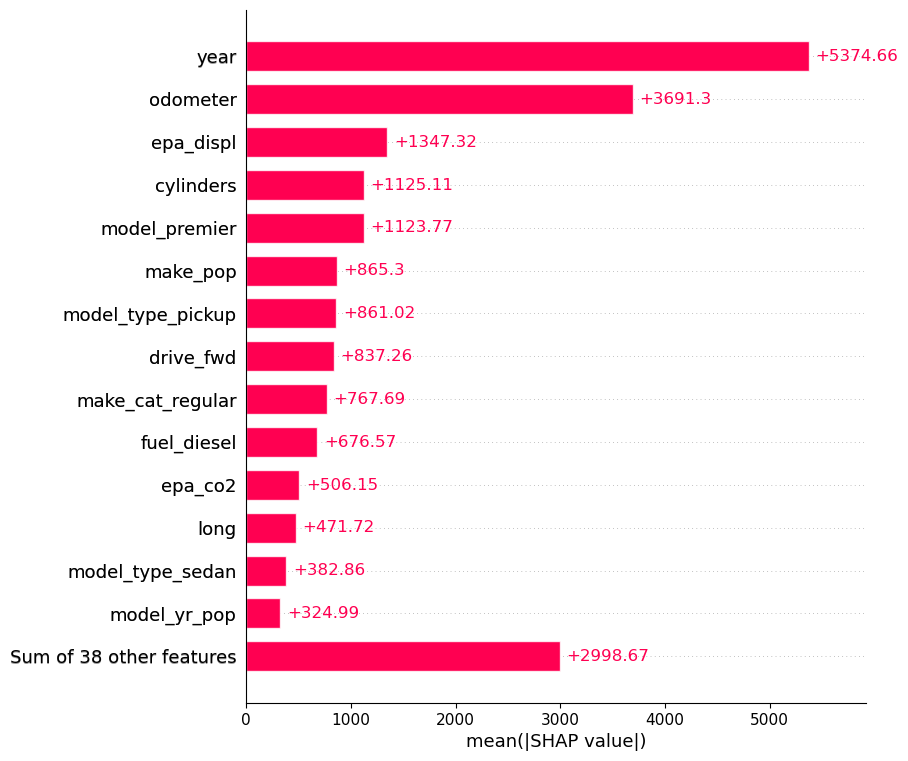

In [79]:
# Reset matplotlib to default style
sns.reset_orig()

# Create bar plot showing top 15 most important features
shap.plots.bar(cb_shap, max_display=15)

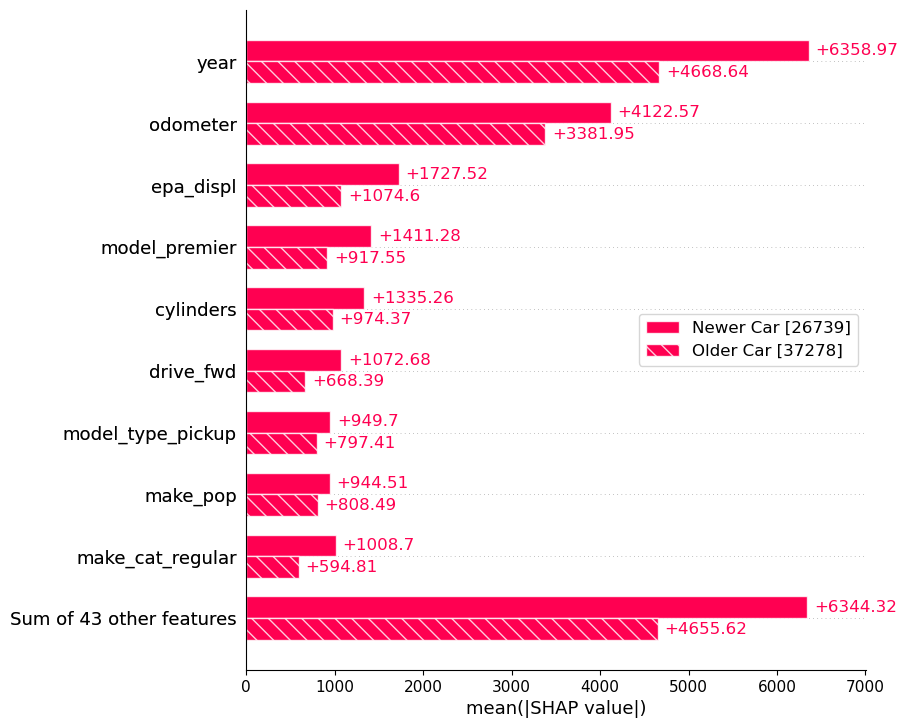

In [82]:
# Create cohort analysis: compare newer vs older cars

# all the top features matter less for “Older cars.” One of the biggest differences is with year itself.
# When a car is older, how much older doesn’t matter as much as when it’s in the “Newer Car” cohort.

yr_cohort = np.where(X_test.year > 2014, "Newer Car", "Older Car")
shap.plots.bar(cb_shap.cohorts(yr_cohort).abs.mean(0))

### SHAP Beeswarm Plot

In [84]:
# PURPOSE: Visualize HOW features affect predictions, not just HOW MUCH.
# Goes beyond bar charts by showing the relationship between feature values
# and their impact on predictions.
#
# WHAT EACH ELEMENT REPRESENTS:
# - Each DOT = one observation
# - DOT COLOR = feature value (red=high, blue=low, gradient in between)
# - HORIZONTAL POSITION = SHAP value (impact on prediction)
#   * Right of zero = positive impact (increases price)
#   * Left of zero = negative impact (decreases price)
# - VERTICAL STACKING = density/frequency (creates histogram effect)
# - VERTICAL ORDER = global feature importance (top=most important)
#
# HOW TO READ THE PLOT:
#
# 1. CONTINUOUS FEATURES (like year, odometer):
#    - Clean color gradient = monotonic relationship
#    - year: Red (high) → right = newer cars increase price ✓
#           Blue (low) → left = older cars decrease price ✓
#    - odometer: Red (high mileage) → left = decreases price
#                Blue (low mileage) → right/center = minimal/positive impact
#                Long tail → some high mileage cars heavily penalized
#
# 2. POPULARITY FEATURES (make_yr_pop, model_yr_pop):
#    - High values (red) → mostly left = negative impact
#    - Counterintuitive: Popular make/model/year combos cost LESS
#      (likely because they're mass-market, not premium)
#
# 3. BINARY FEATURES (0 or 1):
#    - Two distinct colors only (blue=0, red=1)
#    - Clear separation shows feature's directional effect:
#      * model_type_pickup: Red (1) → right = pickups increase price $$
#      * make_cat_regular: Red (1) → left = regular brands decrease price
#      * drive_fwd: Red (1) → mixed = FWD has variable impact
#      * fuel_diesel: Red (1) → right = diesel increases price
#      * model_premier: Split shows luxury vs non-luxury price gap
#
# KEY INSIGHTS:
# - year: Cleanest relationship - newer = more expensive (strong gradient)
# - odometer: Most observations have negative/neutral impact, but long tail
#   shows some high-mileage vehicles are severely penalized
# - Pickup trucks command premium pricing
# - Regular (non-luxury) brands are discounted
# - Binary features often show clear value splits
#
# LIMITATIONS:
# - Can be hard to interpret for features with complex interactions
# - Doesn't show exact feature values (just high/low/medium)
# - Color gradient can be ambiguous for categorical features
# - Doesn't capture feature interactions (see 2D plots for that)
#
# WHEN TO USE:
# - Understanding feature-outcome relationships
# - Identifying monotonic vs complex patterns
# - Communicating insights to non-technical stakeholders
# - Validating domain knowledge (does year actually increase price?)

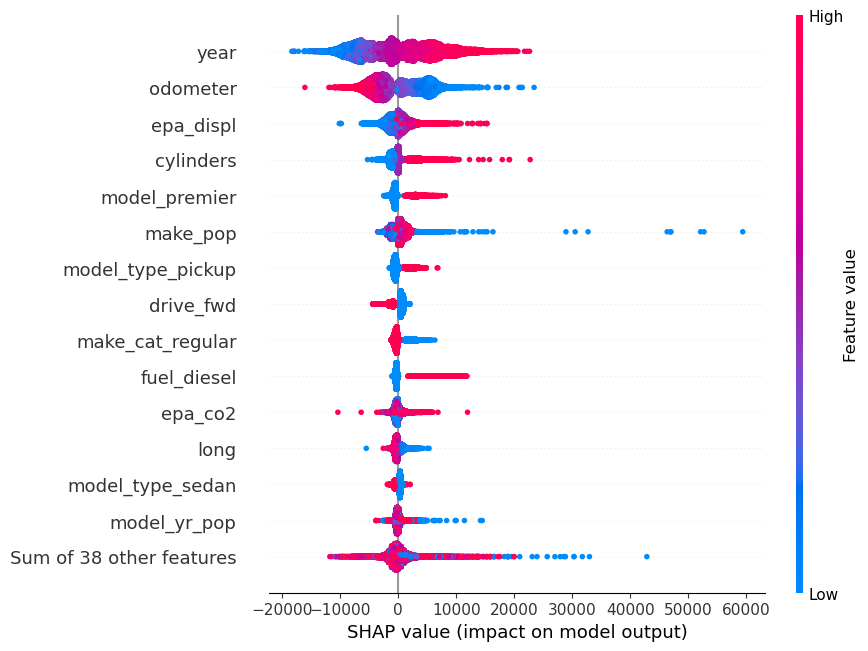

In [85]:
# Create beeswarm plot showing feature value distribution and impact
# Each dot is an observation, color shows feature value, position shows SHAP value
shap.plots.beeswarm(cb_shap, max_display=15)

## Feature summary explanations

In [86]:
# This section will cover a number of methods used to visualize how an individual feature impacts the 
# outcome.

### Partial Dependence Plot (PDP)

In [90]:
# PARTIAL DEPENDENCE PLOTS (PDP)
# - A model-agnostic method to visualize the relationship between ONE feature and the model's predicted outcome.
# - It shows the "marginal effect" — the average impact of a feature on the prediction, after averaging out the effects of all other features.
# - Answers the question: "How does the prediction change, ON AVERAGE, as this one feature's value changes?"
#
# THE TWO-STEP CALCULATION PROCESS:
# The creation of a PDP is best understood as a two-step process, starting with ICE plots.
#
# 1. SIMULATION & INDIVIDUAL CONDITIONAL EXPECTATION (ICE) PLOTS
#    - This is the core simulation step. For a chosen feature (e.g., 'YEAR'):
#      a. Take every observation in your dataset.
#      b. For each observation, create multiple copies of it.
#      c. In each copy, artificially set the 'YEAR' feature to a different value from its possible range
#         (e.g., one copy gets YEAR=1984, another gets YEAR=1985, etc.), while keeping all other features the same.
#      d. Get a model prediction for EACH of these modified copies.
#
#    - The result is a set of INDIVIDUAL lines (one for each original observation), showing how its specific
#      prediction changes as the feature value is altered. This is an ICE plot.
#
# 2. AVERAGING TO CREATE THE PDP
#    - The PDP is simply the AVERAGE of all the individual ICE plot lines.
#    - This creates a single, smooth line representing the general, average trend of the feature's effect on the prediction.
#
# KEY TAKEAWAYS:
# 1. PDP = Average Trend: The final plot shows the overall, average effect of a feature.
# 2. ICE = Individual Stories: The underlying (often unplotted) ICE lines show the individual, heterogeneous
#    effects for each data point before they are averaged.
# 3. Model-Centric View: PDPs reveal what the MODEL has learned about the relationship, which may or may not
#    reflect the true causal relationship in the real world.
# 4. ⚠ CAUTION: Correlation ≠ Causation. A PDP shows the feature's relationship with the prediction, not necessarily a causal link.

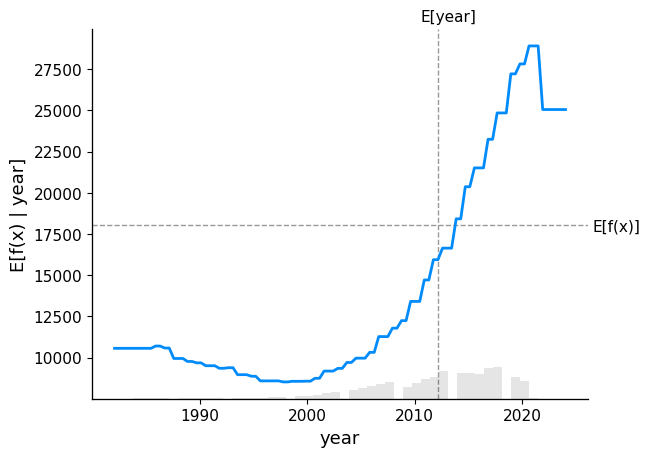

In [133]:
# Create PDP for 'year' feature using SHAP
shap.plots.partial_dependence(
    "year", 
    cb_mdl.predict, 
    X_test,
    ice=False,  # Don't show individual conditional expectation lines
    model_expected_value=True,  # Show baseline prediction
    feature_expected_value=True  # Show average feature value
)

In [134]:
# Create PDP using pdpbox library (more customization options)
pdp_single_feature = pdp.PDPIsolate(
    model=cb_mdl, 
    df=X_test, 
    model_features=X_test.columns, 
    feature='year',
    feature_name='year', 
    n_classes=0,  # Regression (not classification)
    n_jobs=-1  # Use all CPU cores
)

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

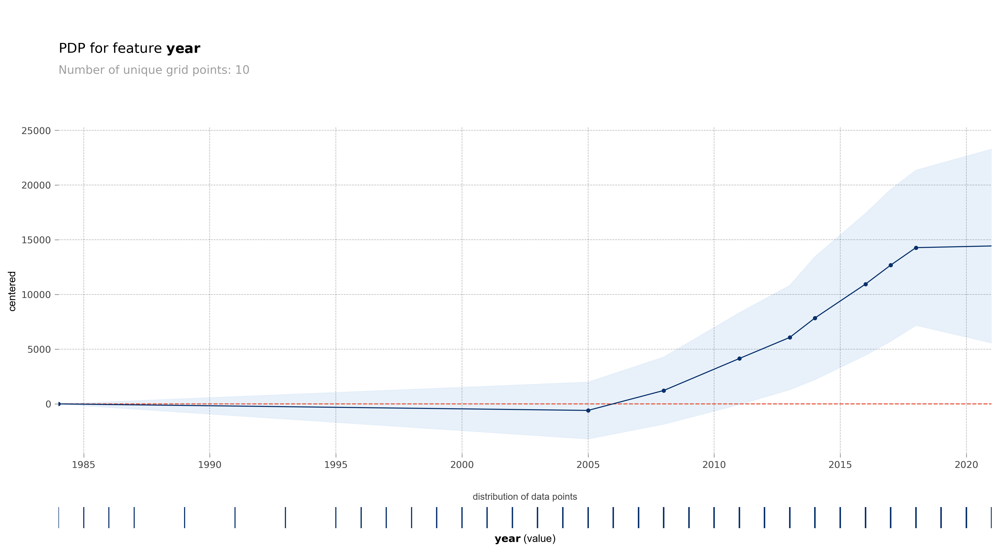

In [144]:
# Plot PDP with data distribution
fig, axes = pdp_single_feature.plot(
    plot_pts_dist=True,
    engine='matplotlib'
)
fig.show()

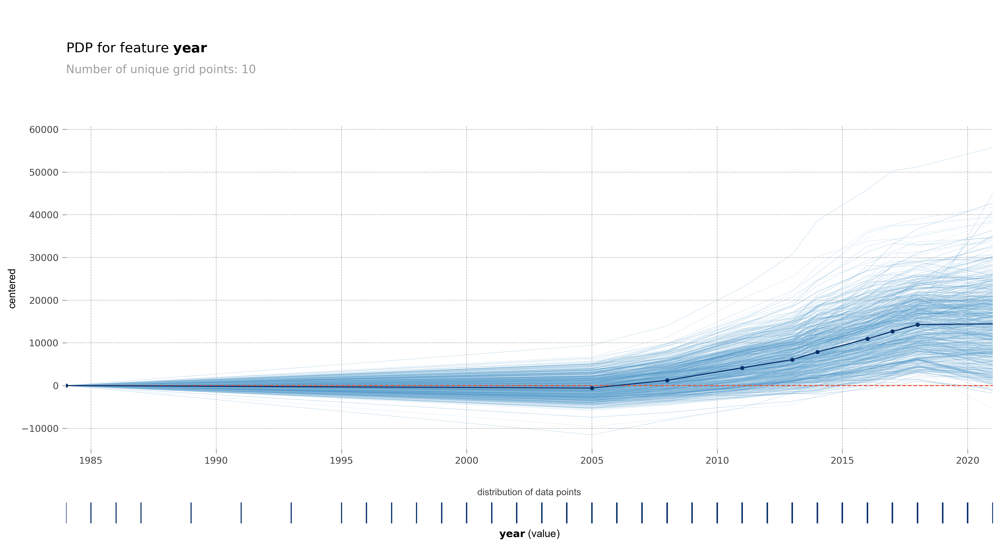

In [141]:
# Plot PDP with individual prediction lines (ICE)
fig, axes = pdp_single_feature.plot(
    plot_pts_dist=True, 
    plot_lines=True,
    frac_to_plot=0.01,  # Show 1% of individual lines
    engine = 'matplotlib'
)
fig.show()

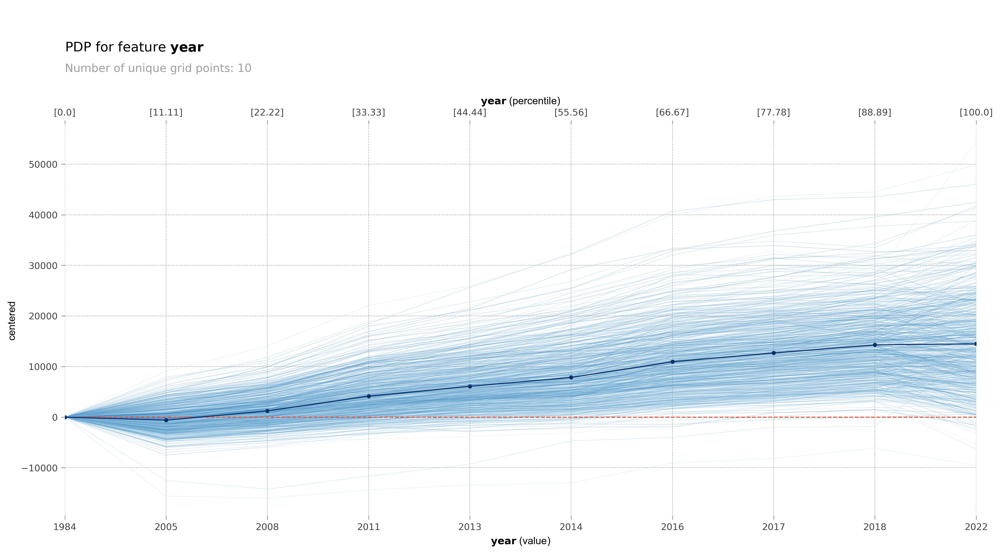

In [142]:
# Plot PDP with binning and percentiles
fig, axes = pdp_single_feature.plot(
    to_bins=True,  # Group into bins
    plot_lines=True,
    frac_to_plot=0.01, 
    show_percentile=True,  # Show percentile markers
    engine = 'matplotlib'
)
fig.show()

In [145]:
# Define feature groups for analysis
cont_feature_l = ['year', 'odometer', 'cylinders', 'epa_displ',
                  'make_pop', 'make_yr_pop', 'model_yr_pop']

make_cat_feature_l = ['make_cat_obsolete', 'make_cat_regular', 
                      'make_cat_premium', 'make_cat_luxury', 
                      'make_cat_luxury_sports']

bin_feature_l = ['model_premier', 'auto_trans']

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

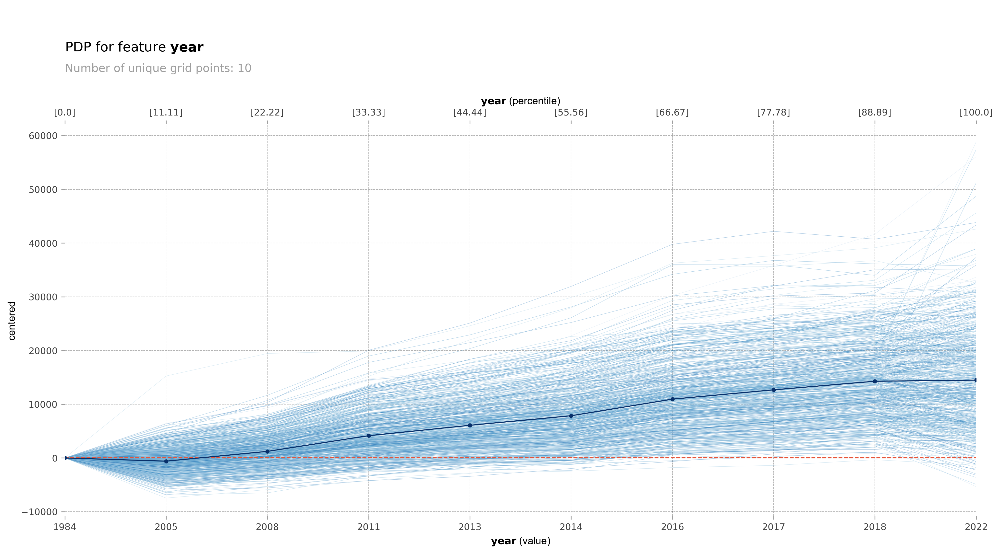

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

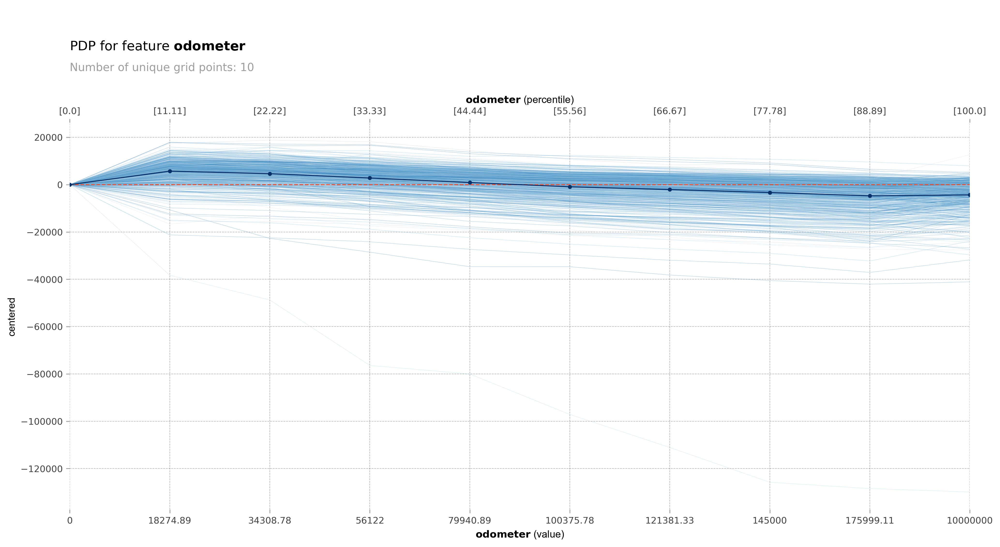

obtain pred_func from the provided model.


  0%|          | 0/5 [00:00<?, ?it/s]

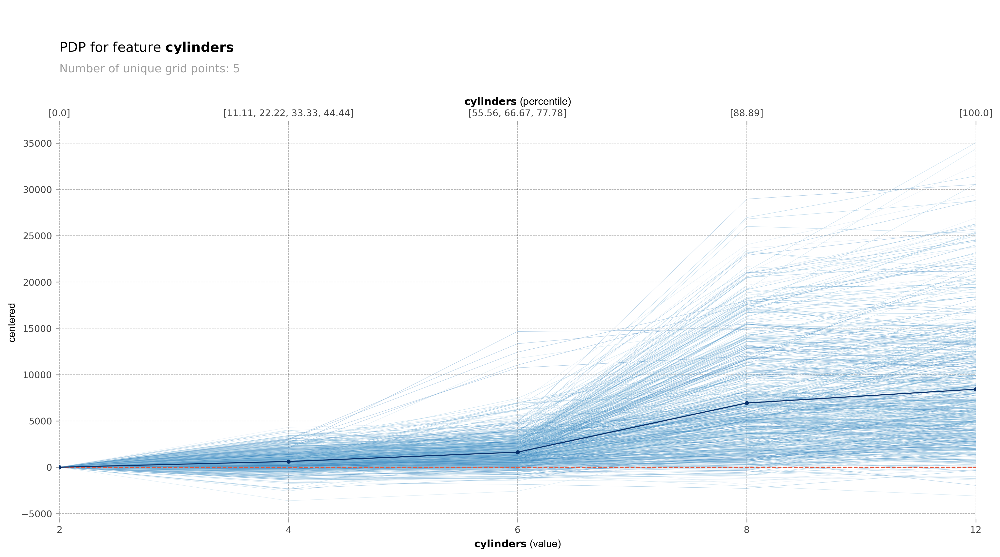

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

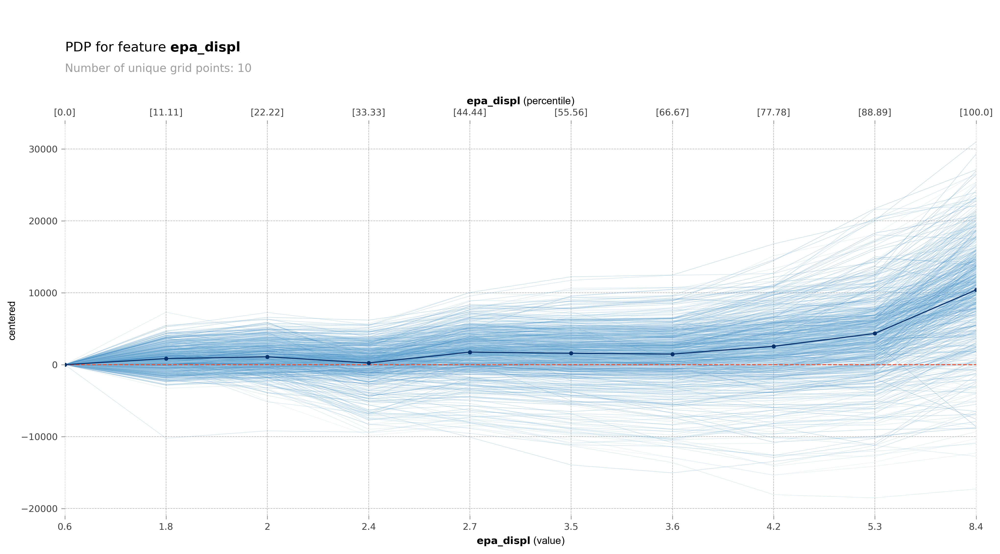

obtain pred_func from the provided model.


  0%|          | 0/9 [00:00<?, ?it/s]

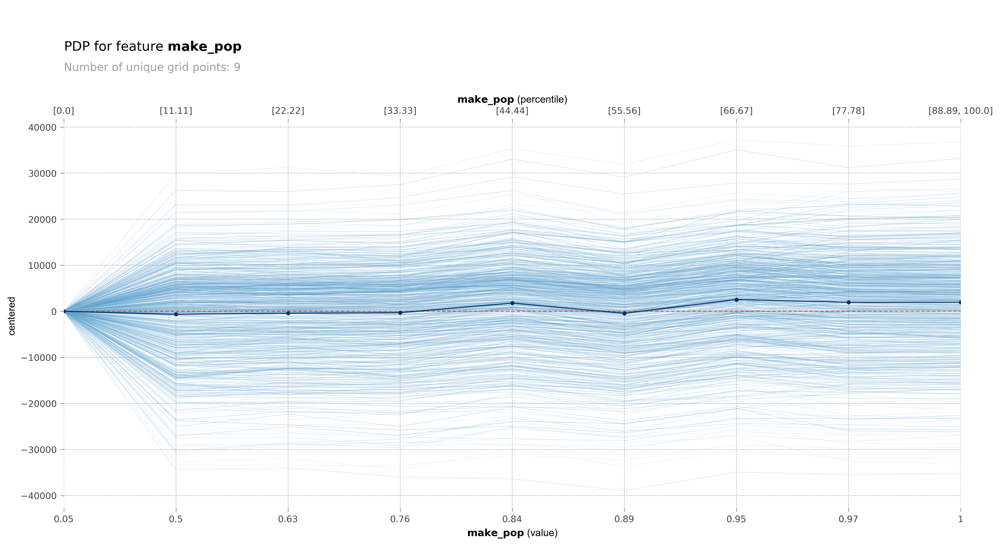

obtain pred_func from the provided model.


  0%|          | 0/9 [00:00<?, ?it/s]

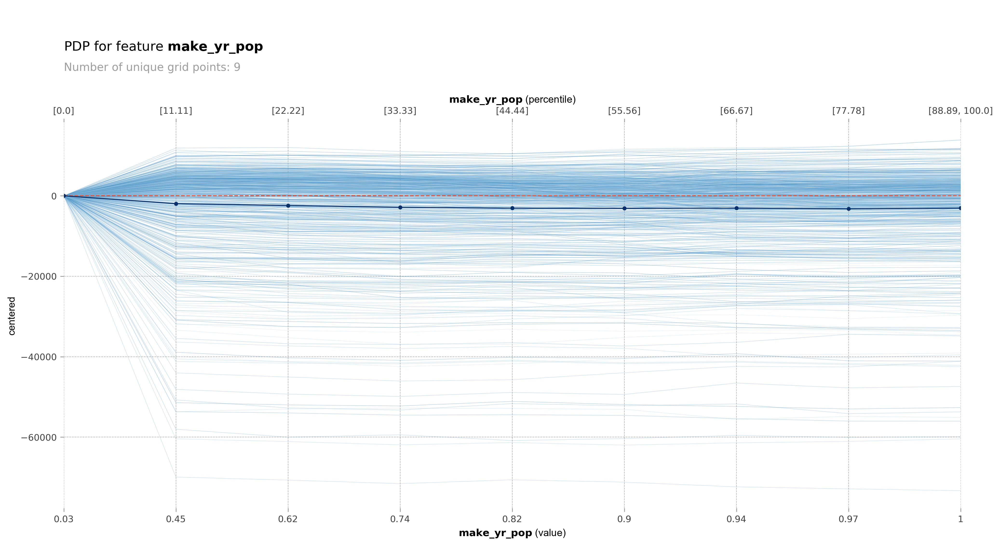

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

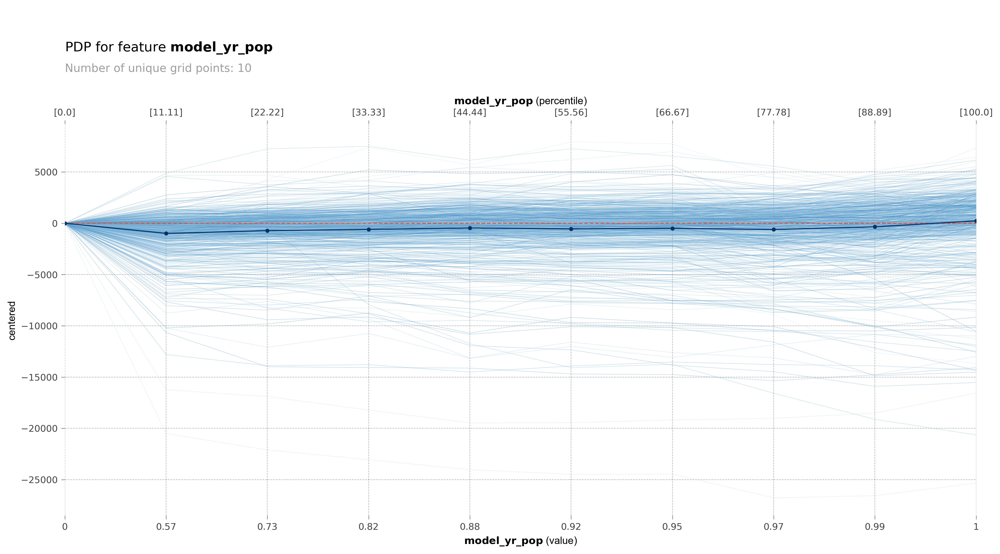

In [146]:
# Create PDPs for all continuous features
for feature in cont_feature_l:
    pdp_single_feature = pdp.PDPIsolate(
        model=cb_mdl, 
        df=X_test, 
        model_features=X_test.columns,
        feature=feature, 
        feature_name=feature, 
        n_classes=0, 
        n_jobs=-1
    )
    fig, axes = pdp_single_feature.plot(
        to_bins=True, 
        plot_lines=True,
        frac_to_plot=0.01, 
        show_percentile=True,
        engine='matplotlib'
    )
    plt.show()

In [148]:
# A low value of odometer correlates with the model outputting a higher price.
# it depicts how it’s mostly monotonically decreasing except in the extremes. 
# It’s interesting that there are odometer values of zero and ten million in the extremes. 
# While it makes sense that the model learned that odometer made no difference in prices when it’s 
# zero, a value of ten million is an anomaly, and for this reason, you can tell that the ICE lines are going 
# in different directions because the model is not sure what to make of such a value. We must also keep 
# in mind that ICE plots, and thus PDPs, are generated with simulations that may create examples that 
# wouldn’t exist in real life, such as a brand-new car with an extremely high odometer value.

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

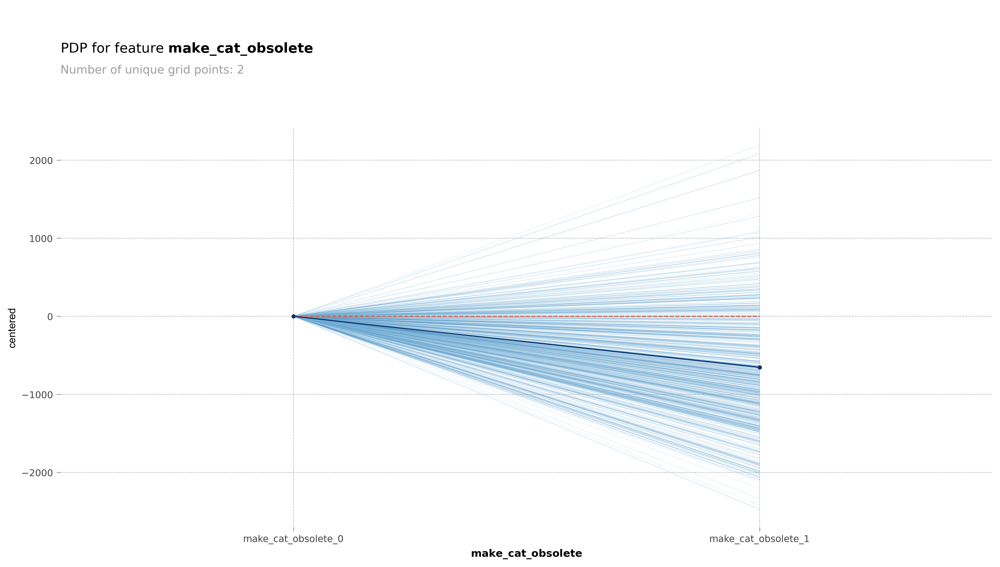

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

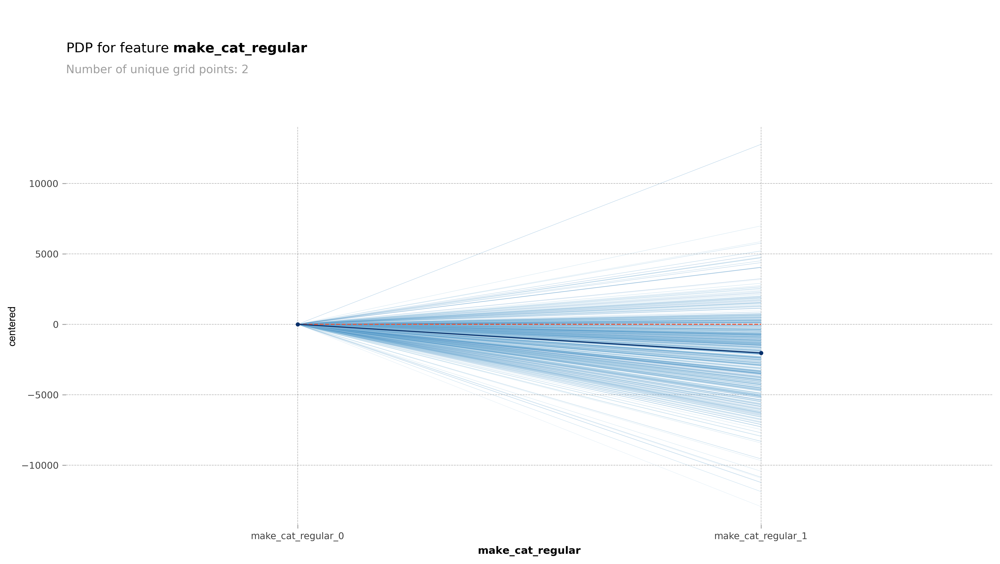

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

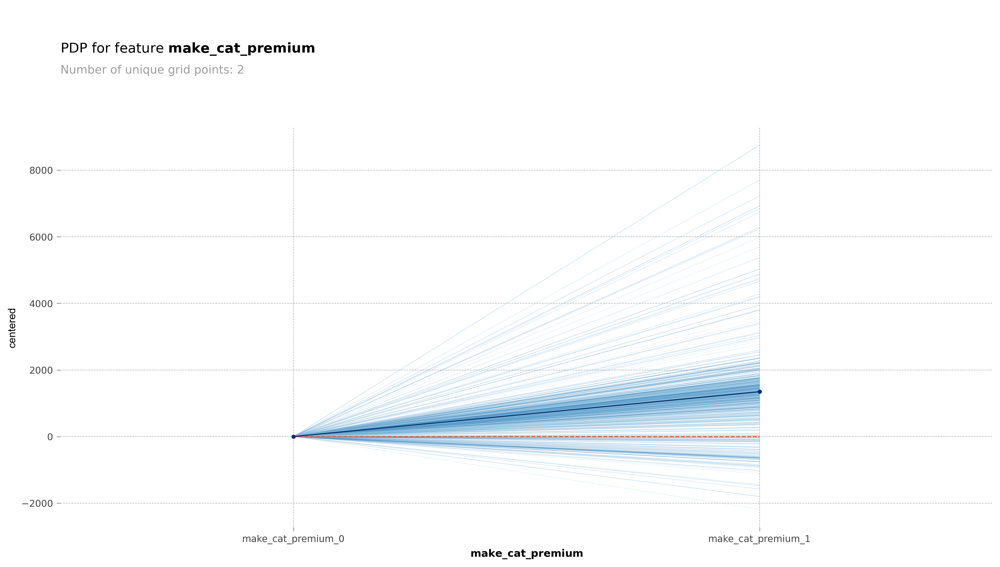

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

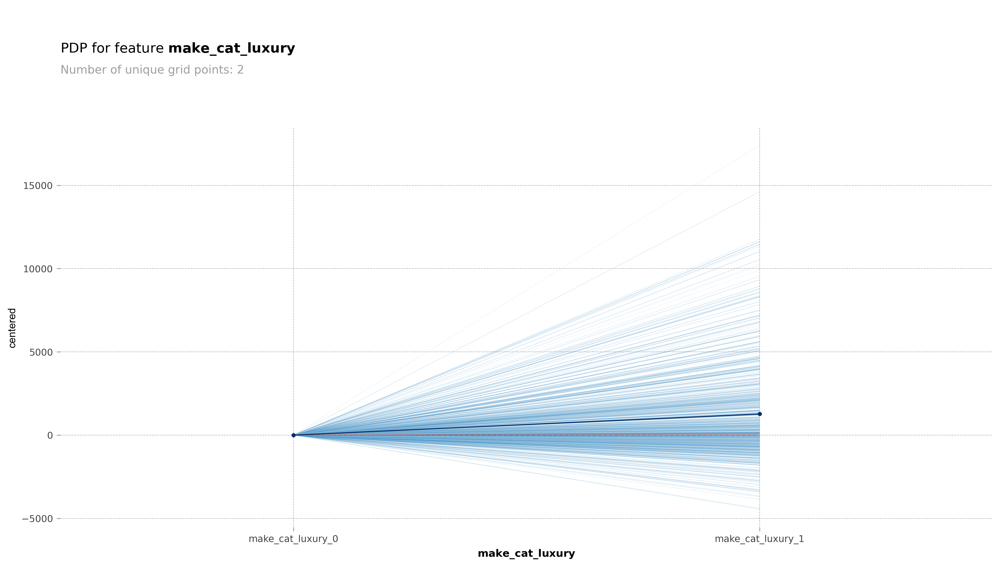

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

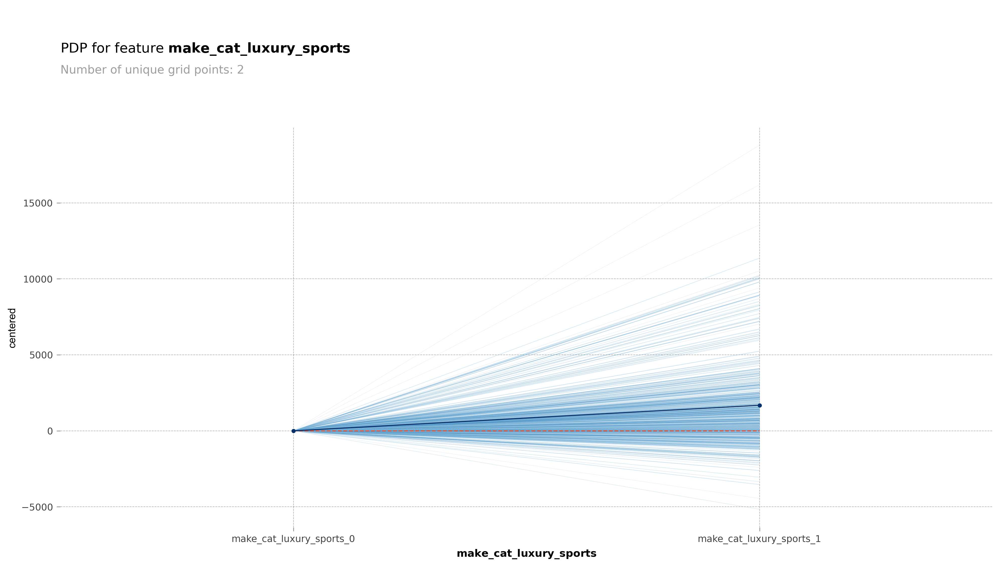

In [147]:
# Create PDPs for categorical make features
for feature in make_cat_feature_l:
    pdp_single_feature = pdp.PDPIsolate(
        model=cb_mdl, 
        df=X_test, 
        model_features=X_test.columns,
        feature=feature, 
        feature_name=feature, 
        n_classes=0, 
        n_jobs=-1
    )
    fig, axes = pdp_single_feature.plot(
        to_bins=True, 
        plot_lines=True,
        frac_to_plot=0.01, 
        show_percentile=True,
        engine='matplotlib'
    )
    plt.show()

In [149]:
# some make categories correlate positively while others negatively with the outcome. This 
# finding shouldn’t be surprising considering some make categories, such as “luxury” are indicative of a 
# high price and others of a lower one. That being said, make_cat is a categorical feature that was one-hot 
# encoded, so it’s not natural to create PDP plots as if each category were an independent binary feature.

obtain pred_func from the provided model.


  0%|          | 0/5 [00:00<?, ?it/s]

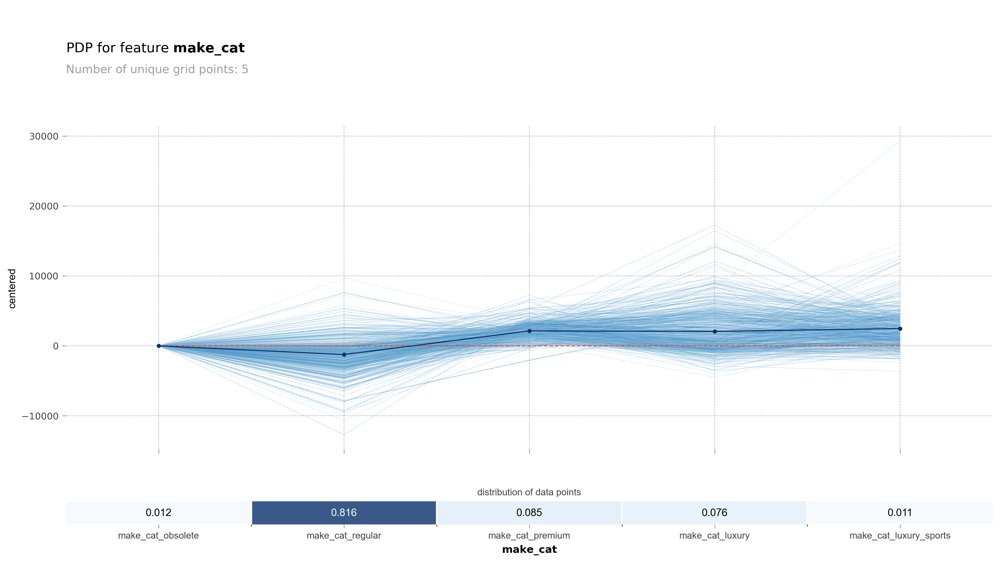

In [150]:
# Create multi-feature PDP for make category
pdp_multi_feature = pdp.PDPIsolate(
    model=cb_mdl, 
    df=X_test, 
    model_features=X_test.columns,
    feature=make_cat_feature_l,  # Multiple features at once
    feature_name="make_cat",
    n_classes=0, 
    n_jobs=-1
)

fig, axes = pdp_multi_feature.plot(
    plot_lines=True, 
    plot_pts_dist=True,
    frac_to_plot=0.01, 
    show_percentile=True,
    engine='matplotlib'
)
fig.show()

obtain pred_func from the provided model.


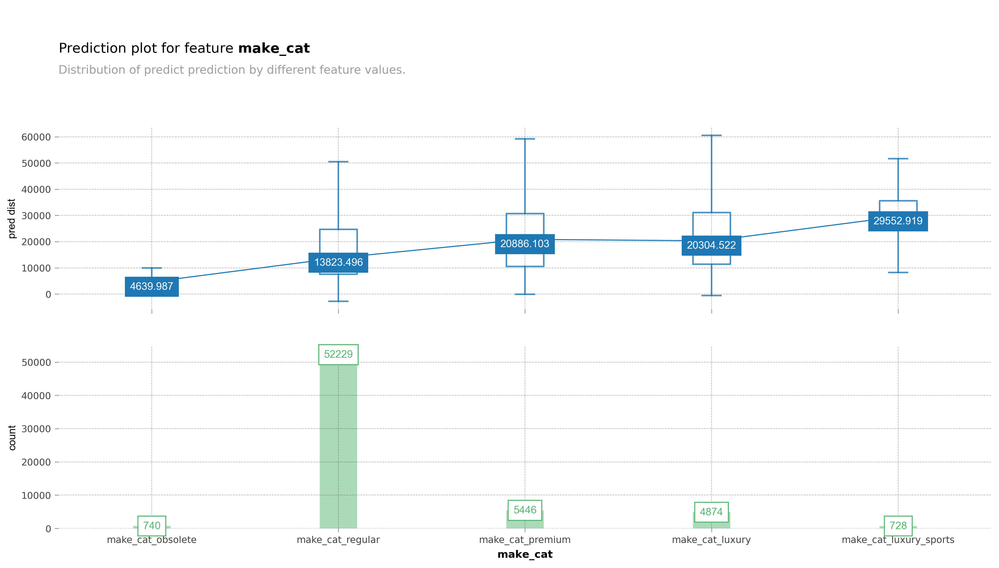

In [151]:
# Create prediction plot for make category
predict_plot = info_plots.PredictPlot(
    model=cb_mdl, 
    df=X_test, 
    model_features=X_test.columns, 
    feature=make_cat_feature_l,
    feature_name="make_cat", 
    n_classes=0
)
fig, _, _ = predict_plot.plot(engine='matplotlib')
fig.show()

In [164]:
# THE SCENARIO (`make_cat` FEATURE):
# - A PDP is created to understand how car category affects the predicted price.
# - The ICE lines underneath the PDP show a lot of variance, indicating the effect is not the same for all cars.
#
# THE PDP's STORY (THE SIMULATION):
# - The PDP for `make_cat` shows that "luxury" and "premium" categories tend to lead to higher prices.
# - However, the average increase shown by the PDP is only about $2,000.
#
# THE REALITY CHECK (vs. ACTUAL PREDICTIONS):
# - A crucial step is to compare the PDP's average trend against a plot (e.g., box plot) of the ACTUAL model predictions.
# - This comparison reveals a major discrepancy:
#   - The difference in average *actual predictions* between "regular" and "luxury/premium" is at least $7,000.
# - Why the difference? The actual predictions account for real-world feature combinations. A premium car is
#   rarely very old with high mileage, a fact the model learns. The box plot reflects these realistic data points.
#
# ⚠ WHY THE DISCREPANCY? THE KEY FLAW OF PDPs
# - THE INDEPENDENCE ASSUMPTION: PDPs operate under the strong and often false assumption that features are independent.
# - UNREALISTIC SCENARIOS: The PDP simulation creates data points that don't exist in reality.
#   - It will, for example, calculate the predicted price for a "luxury sports" car but with the `mileage` and `age` of a junk car.
# - MISLEADING RESULTS: Because it averages the predictions from these unrealistic scenarios, the final PDP line
#   can be misleading and may not represent the true effect of the feature in a real-world context.
#
# PDP: SUMMARY OF PROS AND CONS
#
# ✓ PROS:
#   - Straightforward and intuitive to interpret.
#   - Relatively quick to generate.
#
# ⚠ CONS:
#   - Heavily relies on the feature independence assumption, which is often violated.
#   - The simulation strategy doesn't account for the actual distribution of features.
#   - Can produce counterintuitive or misleading plots by averaging over unrealistic data points.
#
# - Because of these significant drawbacks, alternatives that account for feature correlation are needed.

### SHAP Scatter Plot

In [166]:
# SHAP values are available for every data point, enabling you to plot them against feature values, result
# ing in a PDP-like visualization with model impact (SHAP values) on the y-axis and feature values on the 
# x-axis. Being a similar concept, the SHAP library initially called this a dependence_plot, but now it’s 
# referred to as a scatter plot. Despite the similarities, PDP and SHAP values are calculated differently.

# Creating a SHAP scatter plot is simple, requiring only the explanation object. Optionally, you can col
# or-code the dots according to another feature to understand potential interactions. You can also clip 
# outliers from the x-axis using percentiles with xmin and xmax attributes and make dots 20% opaque 
# (alpha) to identify sparser areas more easily

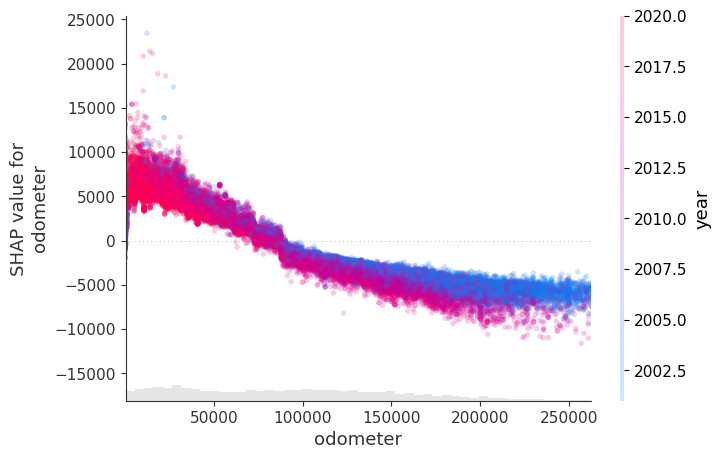

In [165]:
# Scatter plot: odometer vs SHAP value, colored by year
# Shows how odometer's effect changes with vehicle age
shap.plots.scatter(
    cb_shap[:, "odometer"], 
    color=cb_shap[:, "year"],
    xmin="percentile(1)",  # Trim outliers
    xmax="percentile(99)", 
    alpha=0.2  # Transparency for overlapping points
)

In [174]:
# a higher odometer reading negatively impacts the model outcome. Also,
# the color coding shows that the SHAP values for higher years are even lower when the 
# odometer reading is over ninety thousand. In other words, an old car with a high odometer reading 
# is expected, but with a new car, it’s a red flag!

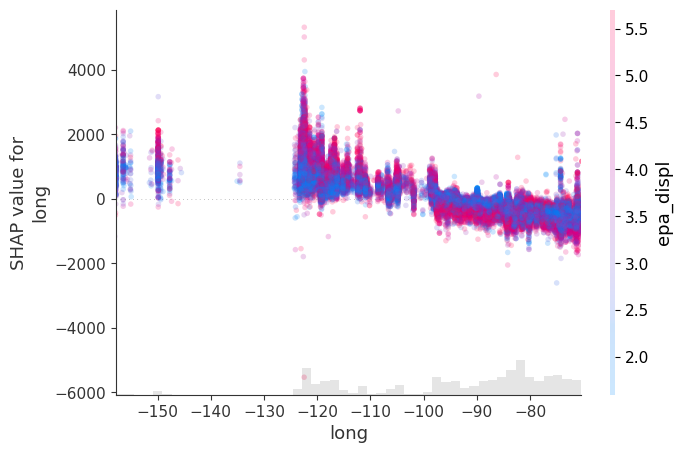

In [173]:
# Scatter plot: longitude vs SHAP value, colored by engine displacement
# Shows geographic effects modulated by engine size
shap.plots.scatter(
    cb_shap[:, "long"], 
    color=cb_shap[:, "epa_displ"],
    xmin="percentile(0.5)", 
    xmax="percentile(99.5)", 
    alpha=0.2,
    x_jitter=0.5  # Add horizontal jitter for visibility
)

In [176]:
# it shows how the west coast of the country (at about -120°) correlates with higher 
# SHAP values and the further east it goes, the lower the SHAP values. Hawaii,
# Anchorage, and Alaska (at about -150°) are also higher than the east coast of the United States 
# (at around -75°). The color coding shows how the more liters displaced of fuel mostly leads to higher 
# SHAP values but it’s not as stark of a difference the further east you go.

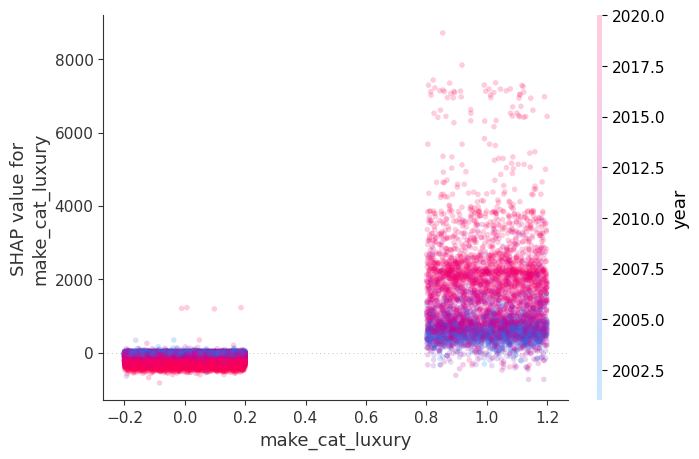

In [177]:
# Scatter plot: luxury make vs SHAP value, colored by year
# Shows how luxury brand effect varies with vehicle age
shap.plots.scatter(
    cb_shap[:, "make_cat_luxury"], 
    color=cb_shap[:, "year"],
    x_jitter=0.4,  # Spread binary values
    alpha=0.2, 
    hist=False  # Don't show histograms
)

In [178]:
# While SHAP scatter plots may be an improvement from PDP plots, SHAP’s tree explainers trade fidel
# ity for speed, causing features that have no influence on the model to potentially have a SHAP value 
# above zero. Fidelity refers to the accuracy of an explanation in representing the behavior of the model. 
# To get higher fidelity, you need to use a method that makes fewer shortcuts in understanding what 
# the model is doing, and even then, some adjustments to parameters like using a greater sample size 
# will increase fidelity too because you are using more data to create the explanations. In this case, the 
# solution is to use KernelExplainer instead because, as we previously discussed, it is more compre
# hensive, but it has issues with feature dependence.

### Accumulated Local Effects (ALE) Plots

In [187]:
# ALE PLOTS (ACCUMULATED LOCAL EFFECTS)
# - A model-agnostic method for visualizing feature effects.
# - Presented as a superior alternative to Partial Dependence Plots (PDPs).
#
# THE KEY ADVANTAGE OVER PDPs
# ✓ Unbiased: ALE plots account for the actual data distribution and the correlation between features.
#   - This solves the main problem with PDPs, which assume feature independence and can create misleading results by averaging over unrealistic data points.
# ✓ Faster: Generally faster to compute than PDPs.
#
# HOW ALE WORKS (THE CORE MECHANISM)
# Instead of averaging predictions for artificial data points, ALE calculates effects locally and then combines them.
#
# 1. Divide Feature Space: The range of the feature is split into small intervals or "windows" (bins).
#
# 2. Calculate Local Effects: Within each small window, the algorithm calculates the *difference* in the model's
#    predictions at the boundaries of the window. This isolates the feature's local effect using only realistic data points.
#
# 3. Accumulate Effects: These local effects are summed up (accumulated) across all the windows to create
#    the final, global ALE plot, which shows the main effect of the feature on the prediction.
#
# PRACTICAL IMPLEMENTATION & PARAMETERS
# - Function: `ale()`
# - Key Inputs: `model`, `data` (e.g., X_test), `feature(s)` to plot.
# - Optional Parameter (`grid_size`):
#   - Defines the number of "windows" to split the feature into.
#   - Default is often 20.
#   - Increasing `grid_size` leads to a more granular plot with higher fidelity, but requires sufficient data within each window.
#
# INTERPRETATION & BEST PRACTICES
# ✓ Confidence Intervals: Shown by default, which helps visualize the uncertainty in the feature effect at different values.
#
# ⚠ Remove Outliers for Better Visualization: This is a critical pre-processing step for ALE plots.
#   - Why? A few extreme data points (e.g., a car worth $8 million, a car from 1950) can "squash" the y-axis of the plot.
#   - This makes it very difficult to see and interpret the meaningful changes for the vast majority of the data.
#
# KEY TAKEAWAYS:
# 1. ALE is generally preferred over PDP because it is unbiased and correctly handles correlated features.
# 2. It works by calculating and accumulating local prediction changes within data windows.
# 3. The `grid_size` parameter is a key knob for tuning the plot's granularity.
# 4. For continuous features, pre-processing your data to handle extreme outliers is crucial for generating a useful and interpretable plot.

In [186]:
# Remove outliers for cleaner ALE plots
X_test_no_outliers = X_test[
    (X_test.year.quantile(.01) <= X_test.year) &
    (X_test.year <= X_test.year.quantile(.99)) &
    (X_test.odometer.quantile(.01) <= X_test.odometer) &
    (X_test.odometer <= X_test.odometer.quantile(.99))
]

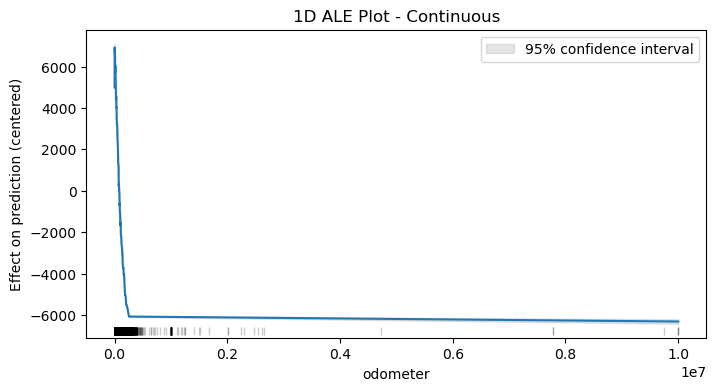

In [183]:
# Create ALE plot for continuous feature (odometer) (with outliers)
ale_effect = ale(
    X=X_test, 
    model=cb_mdl, 
    feature=['odometer'],
    feature_type='continuous',  # Numeric feature
    grid_size=80  # Number of intervals
)
plt.show()

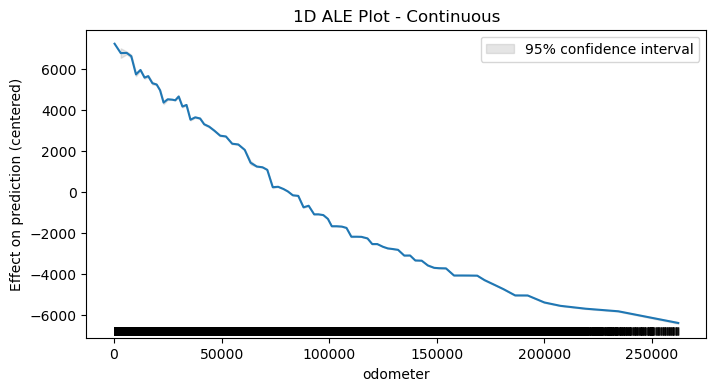

In [184]:
# Create ALE plot for continuous feature (odometer) (without outliers)
ale_effect = ale(
    X=X_test_no_outliers,
    model=cb_mdl, 
    feature=['odometer'],
    feature_type='continuous',  # Numeric feature
    grid_size=80  # Number of intervals
)
plt.show()

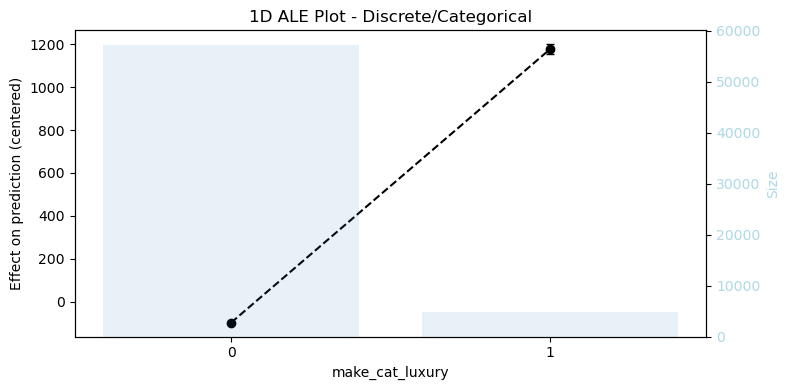

In [185]:
# Create ALE plot for discrete feature (luxury make)
ale_effect = ale(
    X=X_test_no_outliers, 
    model=cb_mdl, 
    feature=['make_cat_luxury'],
    feature_type='discrete'  # Categorical feature
)
plt.show()

In [188]:
# the effect on the model goes from positive to negative as the odometer reading increases.
# However, unlike SHAP, in the ALE plot, it goes negative long before the odometer reaches
# 90,000. Please note the confidence interval is so thin it’s only visible somewhere under
# 10,000. The second ALE plot shows a significant positive impact of the “luxury” category
# on the outcome and that luxury vehicles are not as represented as other ones

## Feature interactions

In [190]:
# THE CORE PRINCIPLE:
# - Features rarely influence a model's prediction in isolation. Their combined effect is often what matters most.
# - The impact of one feature can change depending on the value of another feature.
#
# KEY ANALOGY: PREDICTING OBESITY
# - A person's WEIGHT alone is not enough to predict obesity.
# - The model needs to understand the INTERACTION of weight with other features like HEIGHT, BODY FAT, MUSCLE MASS, etc.
#
# HOW MODELS LEARN INTERACTIONS:
# - Models learn patterns from CORRELATIONS present in the training data.
# - Features in real-world datasets are often naturally related or correlated, even if the relationship isn't linear.
# - Different model types capture these interactions in their own way:
#   - ✓ Decision Trees: May place interacting features on the same decision path or branch.
#   - ✓ Neural Networks: Adjust internal weights and biases in a complex way that implicitly creates interaction effects.

### SHAP Bar Plot with Clustering

In [197]:
# WHAT IT DOES:
# - A SHAP utility that helps identify and visualize feature redundancy.
# - The `shap.utils.hclust` function performs hierarchical clustering on features.
# - It groups features based on their "redundancy" or dependence on each other, as learned by the model.
#
# THE REDUNDANCY SCALE:
# - The clustering algorithm measures dependence on a scale from 0 to 1.
#   - 0 = Complete Redundancy (the features provide identical information).
#   - 1 = Total Independence (the features provide completely separate information).
#
# THE GOAL:
# - To visually group features in the SHAP bar plot that provide similar or overlapping information to the model.
# - This is a powerful way to understand multicollinearity and feature interactions beyond simple correlation matrices.
#
# ⚠ PERFORMANCE CAVEAT:
# - This process is computationally VERY EXPENSIVE and should not be run on the entire dataset.
# - Solution: Use a small, random sample of the data (e.g., 10%) to make it feasible.
#
# THE WORKFLOW:
# 1. SAMPLE THE DATA:
#    - Create a smaller, representative sample of your features and target.
#    - `X_samp = X.sample(frac=0.1)`
#    - `y_samp = y.loc[X_samp.index]`
#
# 2. RUN THE CLUSTERING:
#    - Pass the sampled data to the `hclust` function.
#    - `clustering = shap.utils.hclust(X_samp, y_samp)`
#
# 3. PLOT WITH THE CLUSTERING INFO:
#    - Generate the standard SHAP bar plot.
#    - Pass the `clustering` object and a `clustering_cutoff` parameter.
#
# INTERPRETING THE OUTPUT:
# - `clustering_cutoff`: This parameter defines the threshold for visually grouping features in the plot.
# - Example from text: `clustering_cutoff=0.7`
#   - This will group together any features that are LESS than 0.7 independent.
#   - In other words, it will group features that are MORE than 30% redundant with each other.
#
# KEY TAKEAWAYS:
# 1. This is a powerful tool to quantify and visualize feature dependence from the model's perspective.
# 2. It requires data sampling to be computationally feasible.
# 3. The output directly integrates with SHAP's plotting functions to make feature redundancy immediately obvious on the importance plot.

In [191]:
# Sample 10% of data for clustering
X_samp = X.sample(frac=0.1)
y_samp = y.loc[X_samp.index]

# Perform hierarchical clustering on features
# Groups similar features together based on their effects
clustering = shap.utils.hclust(X_samp, y_samp)

2705it [00:31, 59.65it/s]                                                                                              


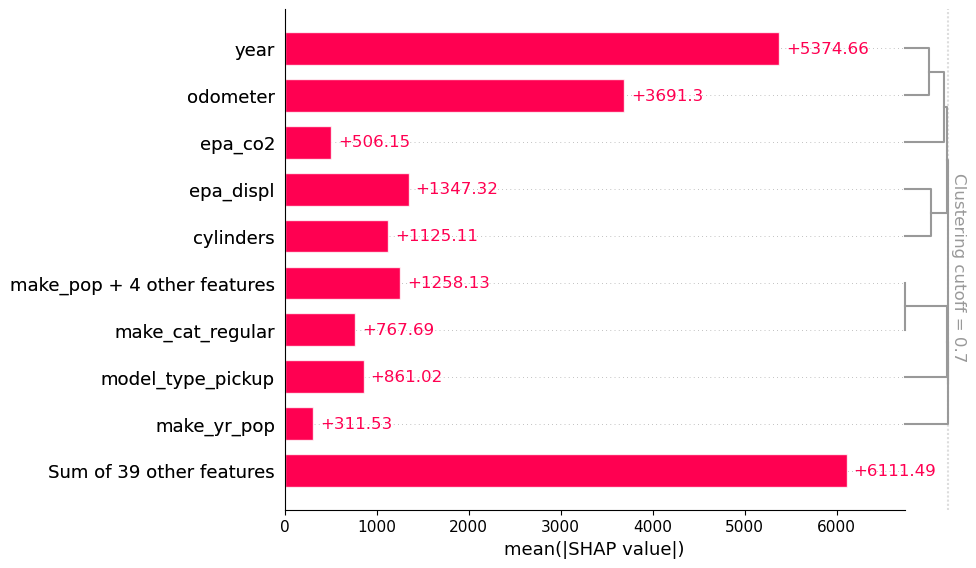

In [192]:
# Display SHAP importance with clustered features
shap.plots.bar(
    cb_shap, 
    clustering=clustering, 
    clustering_cutoff=0.7  # Merge threshold
)

In [194]:
# The dendrogram on the right reveals which features rely on each other the most and at 
# three tiers. For instance, year is dependent on odometer, and when combined, they both depend on 
# epa_co2, which in turn depends indirectly on a number of features, including the fuel displacement 
# (epa_displ) and cylinders features. Also, please note that all make category features depend on each 
# other but also on the make’s relative popularity (make_pop). This finding makes sense because some 
# categories are overall more popular than others. These insights can serve as a guide for subsequent 
# investigations.

### 2D Accumulated Local Effects (ALE) Plots

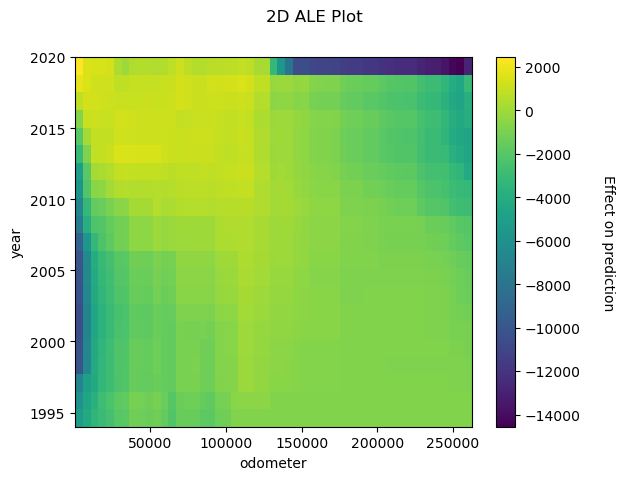

In [200]:
# Create 2D ALE plot for year and odometer interaction
features_l = ["year", "odometer"]
mpl.rcParams["image.aspect"] = "auto"  # Set aspect ratio

ale_effect = ale(
    X=X_test_no_outliers, 
    model=cb_mdl, 
    feature=features_l,
    feature_type='continuous', 
    grid_size=50,  # 50x50 grid
    include_CI=False  # Don't show confidence intervals
)
plt.show()

In [202]:
# Print clustering dendrogram matrix
np.set_printoptions(suppress=True)
print(clustering)

[[  2.          20.           0.           2.        ]
 [ 21.          52.           0.           3.        ]
 [ 22.          53.           0.           4.        ]
 [ 23.          54.           0.           5.        ]
 [ 24.          55.           0.           6.        ]
 [  4.           7.           0.38680011   2.        ]
 [  9.          11.           0.41620517   2.        ]
 [ 43.          44.           0.42938936   2.        ]
 [ 15.          17.           0.45512533   2.        ]
 [ 12.          14.           0.52989352   2.        ]
 [  0.           1.           0.56387955   2.        ]
 [ 61.          62.           0.5797441    4.        ]
 [ 13.          63.           0.59420842   5.        ]
 [ 46.          49.           0.59832066   2.        ]
 [ 10.          57.           0.62910491   3.        ]
 [ 58.          66.           0.67684174   5.        ]
 [ 31.          56.           0.68109715   7.        ]
 [ 51.          65.           0.6936273    3.        ]
 [  5.    

In [203]:
# The array consists of rows of edges. The columns represent node number 1, node number 2, their 
# distance, and parent node number. At the top, there are a few pairs that are completely redundant 
# such as make_pop (feature 2) and make_cat_luxury_sports (feature 21). Not a strange outcome con
# sidering luxury sports cars, like a Ferrari, are the least popular vehicles in the dataset because they 
# aren’t sold as often as, say, a Ford

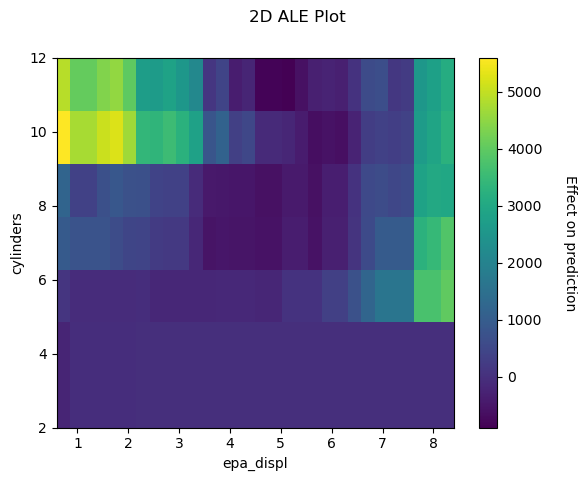

In [204]:
# Create 2D ALE plot for cylinders and displacement interaction
features_l = ["cylinders", "epa_displ"]
ale_effect = ale(
    X=X_test, 
    model=cb_mdl, 
    feature=features_l,
    feature_type='discrete',  # Both treated as discrete
    grid_size=50
)
plt.show()

In [205]:
# higher interaction effects where cylinders is larger than 8 and where 
# epa_displ is under 4. This finding is counterintuitive considering vehicles with a lot of cylinders 
# are unlikely to have low amounts of engine displacement. On the other hand, the higher interaction 
# effects when there are over 4 cylinders and an engine displacement of at least 6 liters make more 
# sense. Please note that there are other factors such as year and model_type that correlate with these 
# two features, but ALE is great at separating the effects of cylinders and epa_displ from other highly 
# correlated features.

### PDP Interactions Plots

In [206]:
# Given the numerous limitations of PDP, when and where should we con
# template using 2D PDP?
# Only when a proven relationship exists between two features, but they are not entirely redundant 
# or independent, and ideally, when they perfectly complement each other. Even then, an ALE plot is 
# advisable as it teases out higher-order effects.

obtain pred_func from the provided model.


  0%|          | 0/15 [00:00<?, ?it/s]

obtain pred_func from the provided model.


  0%|          | 0/15 [00:00<?, ?it/s]

obtain pred_func from the provided model.


  0%|          | 0/225 [00:00<?, ?it/s]

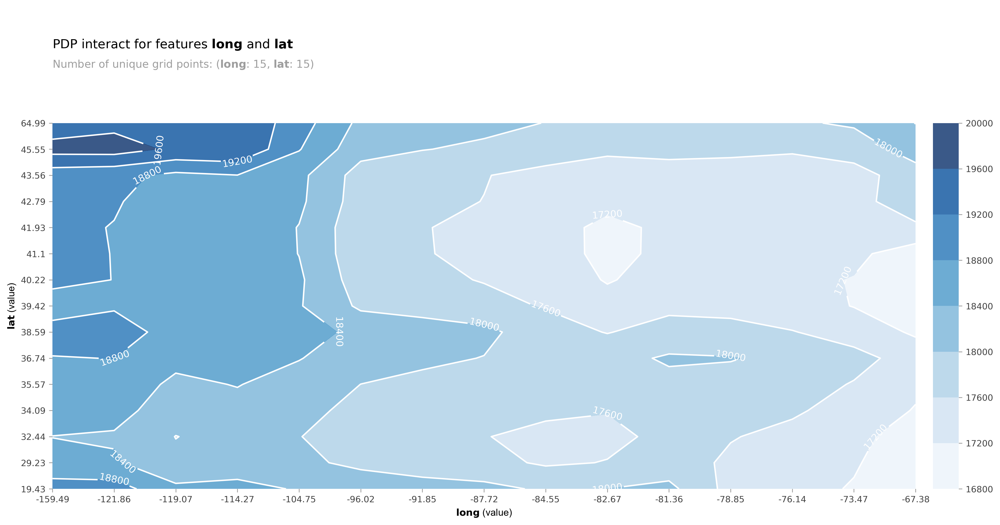

In [208]:
# Create 2D PDP for geographic coordinates (longitude, latitude)
features_l = ["long", "lat"]

pdp_interaction_feature = pdp.PDPInteract(
    model=cb_mdl, 
    df=X_test, 
    model_features=X_test.columns, 
    features=features_l,
    feature_names=features_l, 
    n_classes=0, 
    num_grid_points=15,  # 15x15 grid
    n_jobs=-1
)

# Plot as contour map without marginal PDPs
fig, _ = pdp_interaction_feature.plot(
    plot_type='contour', 
    plot_pdp=False,  # Don't show 1D PDPs
    engine='matplotlib'
)
fig.show()

In [211]:
# long seems to be responsible for most of the effect, but in some areas, 
# lat seems to make a difference, especially in Alaska in the 
# top-left corner. We can check the reliability of this result with
# a 2D predict plot (InteractPredictPlot).

obtain pred_func from the provided model.


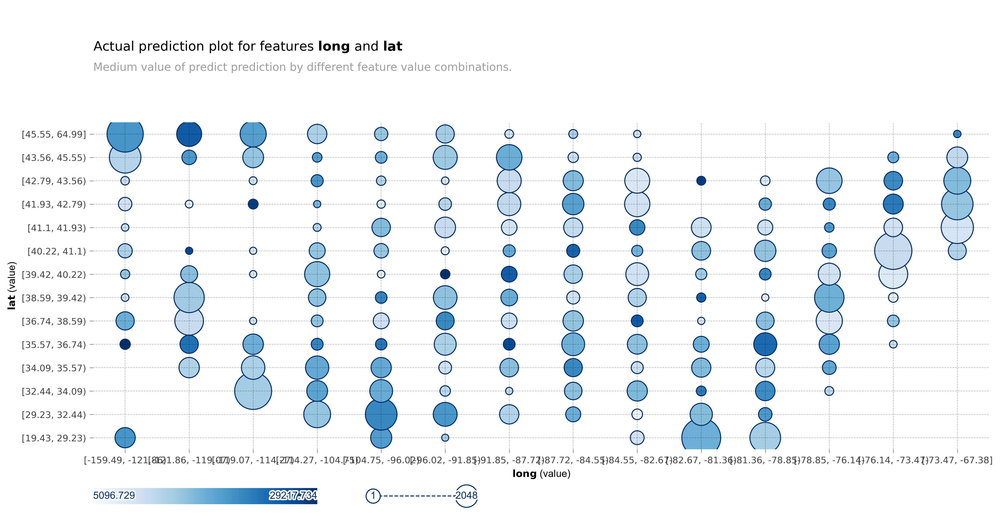

In [212]:
#  the objective is to display the distribution of the data and the predicted scores for 
# that data, but this time, it features a grid of bins that are color-coded for average scores and size-cod
# ed for the number of test observations. We can contrast this with the corresponding 2D target plot 
# (InteractTargetPlot), which does the same but for the labels (target) and not the predicted score:

# Create prediction interaction plot
predict_interact = info_plots.InteractPredictPlot(
    model=cb_mdl, 
    df=X_test, 
    features=features_l,
    feature_names=features_l, 
    model_features=X_test.columns,
    n_classes=0, 
    num_grid_points=15
)
fig, _, _ = predict_interact.plot(engine='matplotlib')
fig.show()

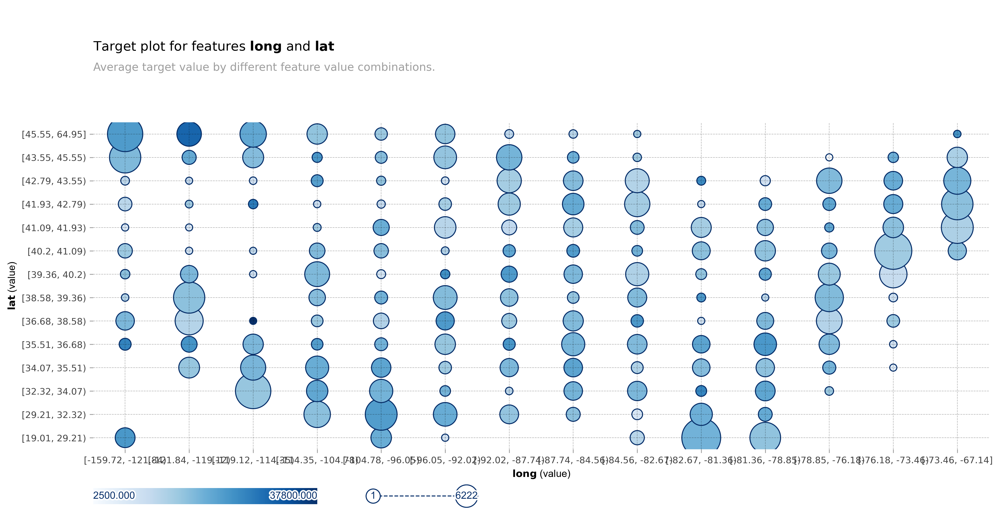

In [210]:
# Create target interaction plot (shows actual target values)
Xy_train = X_train.join(
    pd.Series(y_train, index=X_train.index, name='price')
)

target_interaction = info_plots.InteractTargetPlot(
    df=Xy_train, 
    target='price', 
    features=features_l,
    feature_names=features_l, 
    num_grid_points=15
)
fig, _, _ = target_interaction.plot(engine='matplotlib')
fig.show()

In [213]:
# From the initial plot, it’s evident that the median predictions are greatest on the western half (on the 
# right side) and especially toward the southwest (on the bottom right), but not by much. The second plot 
# affirms that the labels are indeed more likely to be high-priced in these sections of the plot. Therefore, 
# it’s no surprise that the model learned this distribution to its degree of accuracy. These plots aid in 
# affirming a relationship between both features.

In [214]:
# MISSION ACCOMPLISHED: PREDICTING USED CAR PRICES
#
# KEY FINDINGS & INSIGHTS:
# ✓ Successfully identified the key drivers of used car prices for the startup.
# ✓ Discovered that ~15 features have a negligible impact on predictions for either model.
# ✓ A similar number of features hold the "lion's share" of the predictive impact.
# ✓ Most critical features include technical specs like engine displacement (`epa_displ`) and `cylinders`.
#   - Practical Insight: This tells the startup that for an accurate prediction, users must know and enter these technical details.
# ✓ Validated and understood key feature interactions, such as the relationship between `year` and `odometer`.
# ✓ All these findings are actionable and can be shared with the tech startup.
#
# KEY LEARNINGS
#
# 1. UNDERSTOOD DIFFERENT FEATURE IMPORTANCE PARADIGMS:
#    - Model-Specific Methods: Learned what they are and, critically, their shortcomings and inconsistencies.
#    - Model-Agnostic Methods: Learned the calculation and interpretation of two powerful techniques:
#      - ✓ Permutation Feature Importance
#      - ✓ SHAP Values
#
# 2. MASTERED GLOBAL EXPLANATION & VISUALIZATION:
#    - Learned the most common ways to visualize model explanations.
#    - Gained proficiency with different types of global methods, understanding their advantages and disadvantages:
#      - Global Summary Plots (e.g., feature importance bar charts).
#      - Feature Summary Plots (e.g., PDPs, ALE plots).
#      - Feature Interaction Plots (e.g., SHAP clustering, 2D ALE).